# Exploratory Data Analysis of the Dataset

## Master's Dissertation

### Diogo Miguel Alvito | 89576

### Importing Relevant Libraries

In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
from matplotlib import image
import matplotlib.image as mpimg
import seaborn as sns
sns.set()

### Import Subrelevant Libraries

In [2]:
import os
from pathlib import Path
import string
import nltk
from nltk.corpus import stopwords
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')
from IPython.display import display_html
from scipy import stats
# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
#from gensim.models.wrappers import LdaMallet
from gensim.models.coherencemodel import CoherenceModel
from gensim import similarities

# spacy for lemmatization

import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim_models  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)
from pprint import pprint

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# ___________________________________________________________________________________________________________________

### Importing from CXR_JPG | CXR_chexpert, CXR_,_negbio and CXR_split

In [3]:
cxr_chexpert_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\CXR-JPG\cxr_chexpert.csv')
cxr_negbio_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\CXR-JPG\cxr_negbio.csv')
cxr_split_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\CXR-JPG\cxr_split.csv')

In [4]:
cxr_chexpert_df.head(1)

,Unnamed: 0,subject_id,study_id,Atelectasis,Cardiomegaly,Consolidation,Edema,Enlarged Cardiomediastinum,Fracture,Lung Lesion,Lung Opacity,No Finding,Pleural Effusion,Pleural Other,Pneumonia,Pneumothorax,Support Devices
0,0,10000032,50414267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN


In [5]:
cxr_negbio_df.head(1)

,Unnamed: 0,subject_id,study_id,Atelectasis,Cardiomegaly,Consolidation,Edema,Enlarged Cardiomediastinum,Fracture,Lung Lesion,Lung Opacity,No Finding,Pleural Effusion,Pleural Other,Pneumonia,Pneumothorax,Support Devices
0,0,10000032,50414267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN


In [6]:
cxr_split_df.head(1)

,Unnamed: 0,dicom_id,study_id,subject_id,split
0,0,02aa804e-bde0afdd-112c0b34-7bc16630-4e384014,50414267,10000032,train


### Importing from EyeGaze | Fixation Points, Bounding Boxes and Master Sheet

In [7]:
fixations_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\EyeGaze\fixations.csv')
bounding_boxes_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\EyeGaze\bounding_boxes.csv')
master_sheet_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\EyeGaze\master_sheet_with_updated_stayId.csv')

In [8]:
fixations_df.head(5)

,Unnamed: 0,SESSION_ID,MEDIA_ID,DICOM_ID,CNT,Time (in secs),TIMETICK(f=10000000),FPOGX,FPOGY,FPOGS,FPOGD,FPOGID,FPOGV,BPOGX,BPOGY,BPOGV,LPCX,LPCY,LPD,LPS,LPV,RPCX,RPCY,RPD,RPS,RPV,BKID,BKDUR,BKPMIN,LPMM,LPMMV,RPMM,RPMMV,SACCADE_MAG,SACCADE_DIR,VID_FRAME,X_ORIGINAL,Y_ORIGINAL
0,0,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,45,0.72363,6.962164e+11,0.45224,0.33879,0.01794,0.70569,2,1,0.46134,0.26619,1,0.37859,0.59430,18.33718,1.05276,1,0.63790,0.59798,18.19434,1.06068,1,0,0.0,20,3.50648,1,3.56681,1,0.00000,0.00000,0.0,998,1035
1,1,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,68,1.09607,6.962201e+11,0.44419,0.28933,0.73987,0.35620,3,1,0.37864,0.21775,1,0.37749,0.59400,17.92645,1.06068,1,0.63670,0.59809,18.35567,1.06859,1,0,0.0,19,3.73376,1,3.77511,1,55.60791,106.13765,0.0,952,884
2,2,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,86,1.38690,6.962230e+11,0.39018,0.28168,1.11212,0.27478,4,1,0.38154,0.43718,1,0.37654,0.59767,18.14363,1.00879,1,0.63485,0.60175,19.20525,1.00879,1,0,0.0,19,3.65403,1,3.87832,1,104.02783,175.44470,0.0,642,860
3,3,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,120,1.93677,6.962285e+11,0.38444,0.55653,1.45148,0.48529,5,1,0.36100,0.60409,1,0.37433,0.60052,18.41177,1.01495,1,0.63367,0.60434,18.88944,1.01495,1,0,0.0,19,3.67706,1,3.84166,1,297.04248,267.87375,0.0,609,1700
4,4,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,136,2.19574,6.962311e+11,0.41767,0.56057,1.95294,0.24280,6,1,0.51616,0.57667,1,0.38155,0.59675,17.00739,1.02902,1,0.64039,0.60139,17.31119,1.02110,1,0,0.0,19,3.44892,1,3.59534,1,63.95060,356.08780,0.0,800,1713


In [9]:
bounding_boxes_df.head(1)

,Unnamed: 0,dicom_id,bbox_name,x1,x2,y1,y2
0,0,002da0d9-ce49c30d-4dfcc1f8-746d2401-d8044d48,cardiac silhouette,1007.0,1743.0,1278.0,2040.0


In [10]:
master_sheet_df.head(1)

,Unnamed: 0,dicom_id,path,study_id,patient_id,stay_id,gender,anchor_age,image_top_pad,image_bottom_pad,image_left_pad,image_right_pad,dx1,dx1_icd,dx2,dx2_icd,dx3,dx3_icd,dx4,dx4_icd,dx5,dx5_icd,dx6,dx6_icd,dx7,dx7_icd,dx8,dx8_icd,dx9,dx9_icd,normal_reports,Normal,CHF,pneumonia,consolidation,enlarged_cardiac_silhouette,linear__patchy_atelectasis,lobar__segmental_collapse,not_otherwise_specified_opacity___pleural__parenchymal_opacity__,pleural_effusion_or_thickening,pulmonary_edema__hazy_opacity,normal_anatomically,elevated_hemidiaphragm,hyperaeration,vascular_redistribution,atelectasis__chx,cardiomegaly__chx,consolidation__chx,edema__chx,enlarged_cardiomediastinum__chx,fracture__chx,lung_lesion__chx,lung_opacity__chx,no_finding__chx,pleural_effusion__chx,pleural_other__chx,pneumonia__chx,pneumothorax__chx,support_devices__chx,cxr_exam_indication
0,0,24c7496c-d7635dfe-b8e0b87f-d818affc-78ff7cf4,files/p15/p15628804/s58573295/24c7496c-d7635df...,58573295,15628804,33237058.0,F,20 - 30,86,86,448,448,"Heart failure, unspecified",I50.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,NaN,1.0,NaN,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,___F with CHF and shortness of breath// ?Pulm...


### Importing from REFLACX | Metadata

In [11]:
cxr_meta_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\cxr_meta.csv')
cxr_meta_stay_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\cxr_meta_with_stay_id_only.csv')

In [12]:
cxr_meta_df.head(1)

,Unnamed: 0,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,Rows,Columns,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,in_eye_gaze,in_reflacx,StudyDateTime,stay_id
0,177,fa771fa1-d9571d07-bff8f655-327734a7-6e10b29d,10002428,59258773,CHEST (PORTABLE AP),AP,3056,2544,21560419,92717.109,CHEST (PORTABLE AP),antero-posterior,Erect,False,True,2.156042e+12,NaN


In [13]:
cxr_meta_stay_df.head(1)

,Unnamed: 0,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,Rows,Columns,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,in_eye_gaze,in_reflacx,StudyDateTime,stay_id
0,181,4873aa08-977bfd31-fb492e64-6ef432d1-3f12cbe3,10002430,53254222,CHEST (PA AND LAT),PA,3056,2544,21250928,160736.171,CHEST (PA AND LAT),postero-anterior,Erect,True,False,2.125093e+13,31293660


### Importing from Spreadsheets | CXR Meta Datasets

In [14]:
metadata_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\REFLACX\metadata.csv')
metadata_df.head(1)

,Unnamed: 0,id,split,eye_tracking_data_discarded,image,dicom_id,subject_id,image_size_x,image_size_y,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,0,P102R108387,train,False,physionet.org/files/mimic-cxr/2.0.0/files/p18/...,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,2544,3056,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,False,True,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Patients that are presented in the Eye Gaze Study

##### List with DICOM ID'S

In [15]:
patients_dids_eg = cxr_meta_df['dicom_id'].loc[cxr_meta_df['in_eye_gaze'] == True].tolist()
print(len(patients_dids_eg))
print(patients_dids_eg[0:3])

1083
['4873aa08-977bfd31-fb492e64-6ef432d1-3f12cbe3', '8106217e-c41ab813-c6002d3f-ed4ee98b-7b165bae', '5f1ac54d-47dfae00-930fa704-514131fa-ee0c138e']


##### DataFrame

In [16]:
patients_dids_eg_df = cxr_meta_df.loc[cxr_meta_df['in_eye_gaze'] == True]
patients_dids_eg_df.head(1)

,Unnamed: 0,dicom_id,subject_id,study_id,PerformedProcedureStepDescription,ViewPosition,Rows,Columns,StudyDate,StudyTime,ProcedureCodeSequence_CodeMeaning,ViewCodeSequence_CodeMeaning,PatientOrientationCodeSequence_CodeMeaning,in_eye_gaze,in_reflacx,StudyDateTime,stay_id
1,181,4873aa08-977bfd31-fb492e64-6ef432d1-3f12cbe3,10002430,53254222,CHEST (PA AND LAT),PA,3056,2544,21250928,160736.171,CHEST (PA AND LAT),postero-anterior,Erect,True,False,2.125093e+13,31293660.0


#### Checking if all patients present in the eye gaze dataframe are also in the meta data

In [17]:
aux_df = pd.DataFrame(fixations_df.groupby(['DICOM_ID'])['Unnamed: 0'].count())
aux_df.reset_index(inplace=True)
aux_patients_dids_eg = aux_df['DICOM_ID'].tolist()
print(len(aux_patients_dids_eg))

1142


In [18]:
patients_not_in_meta = []

for i in range(len(aux_patients_dids_eg)):
    if aux_patients_dids_eg[i] in patients_dids_eg:
        continue
    else:
        patients_not_in_meta.append(aux_patients_dids_eg[i])

len(patients_not_in_meta)

59

### Loading Chest X-Rays Images

#### Example

In [19]:
img_patient_10002430_01 = mpimg.imread(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_10002430\CXR-JPG\s53254222\590ae2db-d9330aec-1e81d571-d6bd3751-640cee9b.jpg')
img_patient_10002430_02 = mpimg.imread(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_10002430\CXR-JPG\s53254222\4873aa08-977bfd31-fb492e64-6ef432d1-3f12cbe3.jpg')
print(img_patient_10002430_01)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


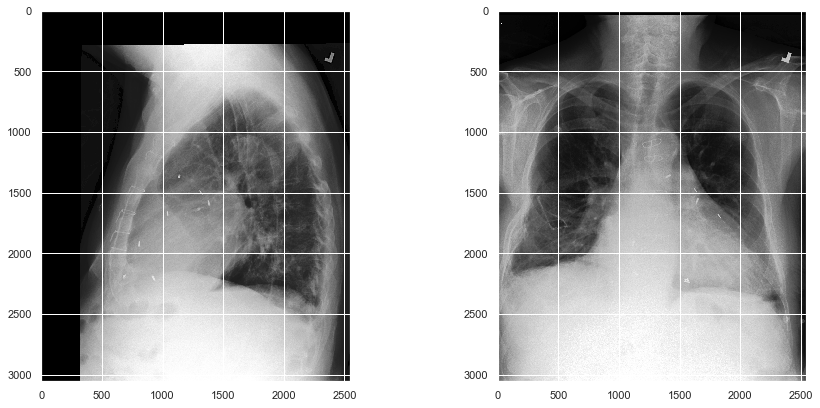

In [20]:
fig = plt.figure(figsize=(15,15))
ax1 = fig.add_subplot(2,2,1)
ax1.imshow(img_patient_10002430_01, cmap='gray')
ax2 = fig.add_subplot(2,2,2)
ax2.imshow(img_patient_10002430_02, cmap='gray')

#### Using color filters

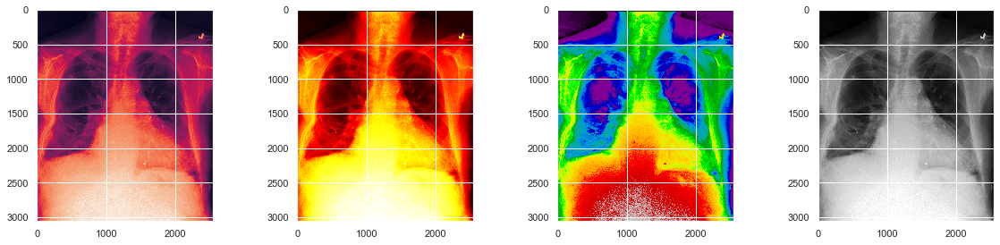

In [21]:
fig = plt.figure(figsize=(20,20))
ax1 = fig.add_subplot(4,4,1)
ax1.imshow(img_patient_10002430_02)
ax2 = fig.add_subplot(4,4,2)
ax2.imshow(img_patient_10002430_02, cmap='hot')
ax3 = fig.add_subplot(4,4,3)
ax3.imshow(img_patient_10002430_02, cmap='nipy_spectral')
ax4 = fig.add_subplot(4,4,4)
ax4.imshow(img_patient_10002430_02, cmap='gray')

### Experience of Bounding Boxes and Fixation Points

#### Creating an example

In [22]:
example_id = cxr_meta_df['subject_id'].loc[cxr_meta_df['dicom_id'] == '1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b'].tolist()
example_id

[17787251]

In [23]:
img_patient_17787251_01 = mpimg.imread(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_17787251\CXR-JPG\s50168226\1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b.jpg')
img_patient_17787251_02 = mpimg.imread(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_17787251\CXR-JPG\s50168226\bff5ebcc-30d60faa-2169ea69-3091195a-44699dec.jpg')

In [24]:
fixation_points_eg_df = pd.DataFrame(fixations_df.loc[fixations_df['DICOM_ID'] == '1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b'])
fixation_points_eg_df.head(2)

,Unnamed: 0,SESSION_ID,MEDIA_ID,DICOM_ID,CNT,Time (in secs),TIMETICK(f=10000000),FPOGX,FPOGY,FPOGS,FPOGD,FPOGID,FPOGV,BPOGX,BPOGY,BPOGV,LPCX,LPCY,LPD,LPS,LPV,RPCX,RPCY,RPD,RPS,RPV,BKID,BKDUR,BKPMIN,LPMM,LPMMV,RPMM,RPMMV,SACCADE_MAG,SACCADE_DIR,VID_FRAME,X_ORIGINAL,Y_ORIGINAL
0,0,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,45,0.72363,6.962164e+11,0.45224,0.33879,0.01794,0.70569,2,1,0.46134,0.26619,1,0.37859,0.5943,18.33718,1.05276,1,0.6379,0.59798,18.19434,1.06068,1,0,0.0,20,3.50648,1,3.56681,1,0.00000,0.00000,0.0,998,1035
1,1,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,68,1.09607,6.962201e+11,0.44419,0.28933,0.73987,0.35620,3,1,0.37864,0.21775,1,0.37749,0.5940,17.92645,1.06068,1,0.6367,0.59809,18.35567,1.06859,1,0,0.0,19,3.73376,1,3.77511,1,55.60791,106.13765,0.0,952,884


#### Image Size

In [25]:
from PIL import Image

im = Image.open(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_17787251\CXR-JPG\s50168226\1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b.jpg')
width, height = im.size
print(width)
print(height)

2544
3056


#### Setting marks on fixation points

In [26]:
data = image.imread(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_17787251\CXR-JPG\s50168226\1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b.jpg')

In [27]:
x_coordinates = fixation_points_eg_df['X_ORIGINAL'].tolist()
y_coordinates = fixation_points_eg_df['Y_ORIGINAL'].tolist()

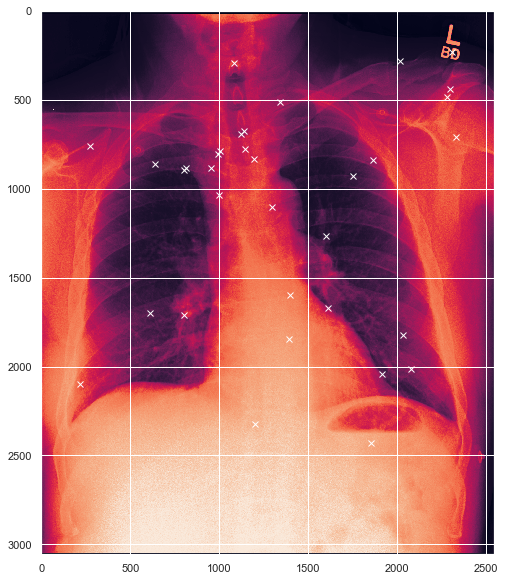

In [190]:
x = x_coordinates
y = y_coordinates

plt.figure(figsize=(10,10))
for i in range(len(x_coordinates)):
    plt.plot(x[i], y[i], marker='x', color='white', alpha=1)
plt.imshow(data)
plt.show()

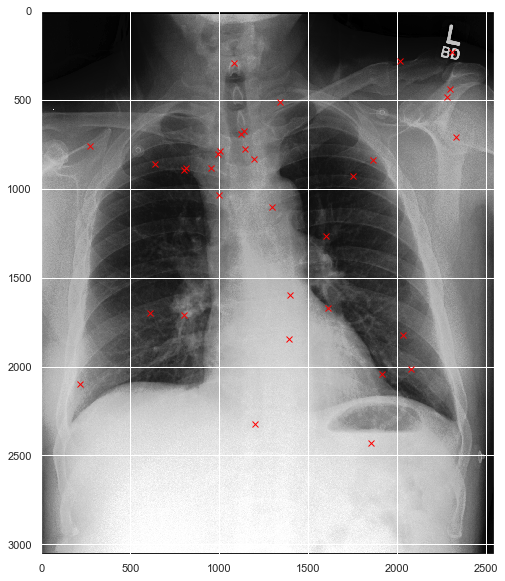

In [29]:
x = x_coordinates
y = y_coordinates

plt.figure(figsize=(10,10))
for i in range(len(x_coordinates)):
    plt.plot(x[i], y[i], marker='x', color='red', alpha=1)
plt.imshow(data, cmap='gray')
plt.show()

#### Setting Bounding Boxes

In [30]:
bounding_boxes_eg_df = pd.DataFrame(bounding_boxes_df.loc[bounding_boxes_df['dicom_id'] == '1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b'])
bounding_boxes_eg_df

,Unnamed: 0,dicom_id,bbox_name,x1,x2,y1,y2
1870,1870,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,cardiac silhouette,927.0,1896.0,1473.0,2332.0
1871,1871,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left clavicle,1268.0,2305.0,259.0,750.0
1872,1872,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left costophrenic angle,2210.0,2483.0,2223.0,2496.0
1873,1873,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left hilar structures,1255.0,1732.0,1132.0,1746.0
1874,1874,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left lower lung zone,1337.0,2346.0,1664.0,2428.0
1875,1875,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left lung,1255.0,2346.0,450.0,2428.0
1876,1876,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left mid lung zone,1268.0,2196.0,1227.0,1664.0
1877,1877,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,left upper lung zone,1255.0,2073.0,491.0,1227.0
1878,1878,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,right clavicle,95.0,1132.0,259.0,750.0
1879,1879,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,right costophrenic angle,27.0,300.0,2237.0,2510.0


In [31]:
x1 = bounding_boxes_eg_df['x1'].tolist()
x2 = bounding_boxes_eg_df['x2'].tolist()
y1 = bounding_boxes_eg_df['y1'].tolist()
y2 = bounding_boxes_eg_df['y2'].tolist()
box_name = bounding_boxes_eg_df['bbox_name'].tolist()
len(x1)

17

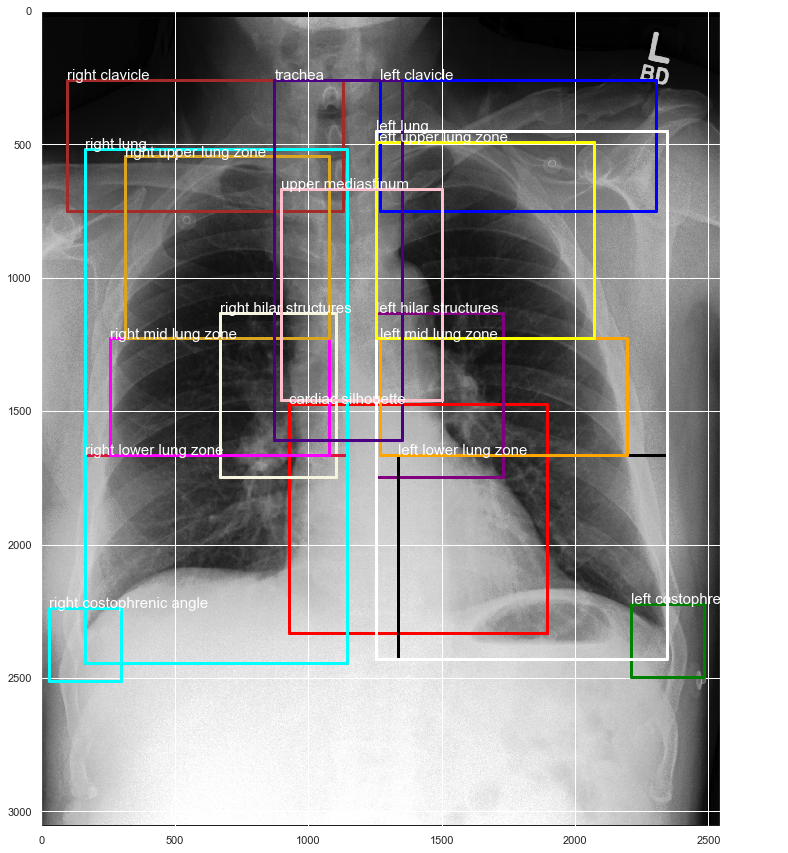

<Figure size 432x288 with 0 Axes>

In [32]:
plt.figure(figsize=(15,15))
cols = ['red', 'blue', 'green', 'purple', 'black', 'white', 'orange', 'yellow', 'brown', 'aqua', 'beige', 'crimson', 'cyan', 'fuchsia', 'goldenrod', 'indigo', 'pink']
for i in range(len(x1)):
    plt.plot([x1[i], x2[i]], [y1[i], y1[i]], color=cols[i], linewidth=3)
    plt.plot([x2[i], x2[i]], [y1[i], y2[i]], color=cols[i], linewidth=3)
    plt.plot([x2[i], x1[i]], [y2[i], y2[i]], color=cols[i], linewidth=3)
    plt.plot([x1[i], x1[i]], [y2[i], y1[i]], color=cols[i], linewidth=3)
    plt.text(x1[i], y1[i], box_name[i], color='white', fontsize=15)
plt.imshow(data, cmap='gray')
plt.show()
plt.savefig('bounding_boxes.png')

### Import Transcription Example

In [33]:
transcription_txt = open(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_10002428\REFLACX\P300R081391\transcription (1).txt')
transcription_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_10002428\REFLACX\P300R081391\timestamps_transcription.csv')

In [34]:
transcription_txt = transcription_txt.read()

In [35]:
print('Doctor examination on patient 10002428: ', "'", transcription_txt, "'")
transcription_df

Doctor examination on patient 10002428:  ' left picc line tip is in the left brachiocephalic vein. there are bilateral pleural effusions and likely atelectasis versus consolidation. no pneumothorax. the heart is normal size. pulmonary vessels are normal. no acute osseous abnormality. '


,word,timestamp_start_word,timestamp_end_word
0,left,14.49,14.69
1,picc,14.69,14.91
2,line,14.91,15.23
3,tip,15.92,16.15
4,is,16.15,16.33
5,in,16.33,16.47
6,the,16.47,16.71
7,left,16.93,17.28
8,brachiocephalic,17.34,18.12
9,vein,18.12,18.46


### Import all transcriptions

In [36]:
path = r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\audio_scripts'
os.chdir(path)


audio_transcripts = []

def read_text_file(file_path):
    with open(file_path, 'r') as f:
        print(f.read())
        
  
for file in os.listdir():
    if file.endswith(".txt"):
        file_path = f"{path}\{file}"
        read_text_file(file_path)
        txt = Path(file_path).read_text()
        audio_transcripts.append(txt)

there is mild bibasilar atelectasis. the heart and pulmonary vessels are normal. no effusions or pneumothorax. no acute osseous abnormality.
marked cardiomegaly is present. a mechanical aortic valve is present. the sternal wires are intact. opacity in the basal left hemithorax is likely a combination of pleural fluid and adjacent lung atelectasis. no acute osseous abnormality is present.
support apparatus. no pneumothorax. cardiac silhouette in the upper limits of normal in size. probable bibasilar atelectasis.
partially visualized thoracolumbar spinal fixation hardware. multiple mediastinal surgical clips and sternotomy wires. enlarged cardiac silhouette. layering opacities in the lung bases may represent atelectasis or pleural fluid. no visualized pneumothorax. no acute osseous abnormality.
exam is limited because of the underpenetrated technique. opacities at the lung bases could represent atelectasis or consolidation. small right pleural effusion. moderate cardiomegaly. no acute os

### Spliting transcriptions into words and counting

In [37]:
# initializing punctuations string
punc = '''!()-[]{};:'"\,<>./?@#$%^&*_~'''
 
# Removing punctuations in string
# Using loop + punctuation string
for i in range(len(audio_transcripts)):
    for ele in audio_transcripts[i]:
        if ele in punc:
            audio_transcripts[i] = audio_transcripts[i].replace(ele, "")

In [38]:
words_dict = dict()


for line in audio_transcripts:
    line = line.strip()
    line = line.lower()

    words = line.split(" ")
  
    
    for word in words:
        if word in words_dict:
            words_dict[word] = words_dict[word] + 1
        else:
            words_dict[word] = 1

words_count_df = pd.DataFrame(list(words_dict.items()))

In [39]:
words_count_df.sort_values(1, ascending=False).head(10)

,0,1
12,no,5629
5,the,3676
1,is,3254
11,normal,2372
18,abnormality,2184
16,acute,2184
17,osseous,2149
37,pleural,2113
15,pneumothorax,2112
75,right,2098


In [40]:
words_count_df_aux = words_count_df.loc[words_count_df[0] != 'of']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'the']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'is']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'are']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'and']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'in']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'or']
words_count_df_aux = words_count_df_aux.loc[words_count_df[0] != 'a']

In [41]:
x_words = words_count_df_aux.sort_values(1, ascending=False).head(20)[0].tolist()
y_frequency = words_count_df_aux.sort_values(1, ascending=False).head(20)[1].tolist()

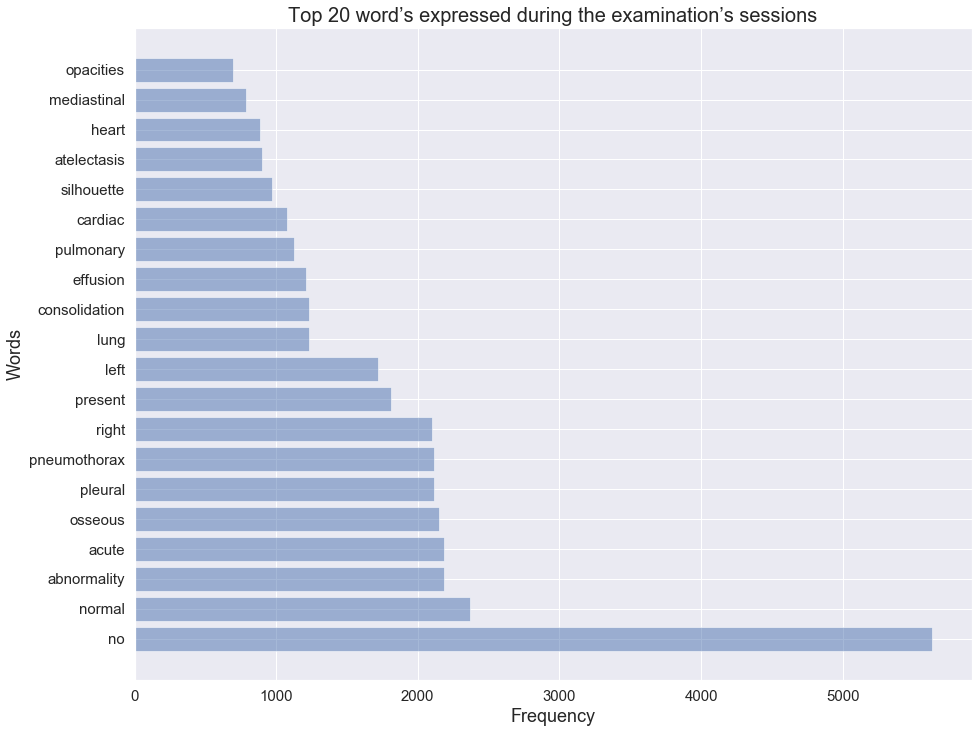

In [42]:
plt.figure(figsize=(15,12))
plt.barh(x_words, y_frequency, align='center', alpha=0.5)
plt.xlabel('Frequency', size =18)
plt.ylabel('Words', size =18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.title("Top 20 word’s expressed during the examination’s sessions", size=20)

plt.show()

### Spliting Transcripts by multiple words

In [43]:
class transcripts2words:
    def __init__(self):
        self.input = None
        self.output = None

    def transcripts_to_words(self, transcripts):
        self.words = []
        for transcript in transcripts:
            splitcomment = nltk.word_tokenize(transcript) 
            for word in splitcomment:
                self.words.append(word)
        return self.words

    def bigram(self, transcripts):
        words = self.transcripts_to_words(transcripts)
        self.finder2 = nltk.collocations.BigramCollocationFinder.from_words(words)
        self.words2_count_df = pd.DataFrame(self.finder2.ngram_fd.most_common())
        return self.words2_count_df

    def trigram(self, transcripts):
        words = self.transcripts_to_words(transcripts)
        self.finder3 = nltk.collocations.TrigramCollocationFinder.from_words(words)
        self.words3_count_df = pd.DataFrame(self.finder3.ngram_fd.most_common())
        return self.words3_count_df

    def quadgram(self, transcripts):
        words = self.transcripts_to_words(transcripts)
        self.finder4 = nltk.collocations.QuadgramCollocationFinder.from_words(words)
        self.words4_count_df = pd.DataFrame(self.finder4.ngram_fd.most_common())
        return self.words4_count_df

In [44]:
t2w = transcripts2words()
bigram_df = t2w.bigram(audio_transcripts)
trigram_df = t2w.trigram(audio_transcripts)
quadgram_df = t2w.quadgram(audio_transcripts)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     8950
Trigram    |     19828
Quadgram   |     31032


In [45]:
bigram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)
bigram_df.head(10)

,N-gram,Count
0,"(no, acute)",2134
1,"(acute, osseous)",1974
2,"(osseous, abnormality)",1928
3,"(no, pneumothorax)",1615
4,"(is, present)",1340
5,"(in, the)",1125
6,"(pleural, effusion)",1117
7,"(pneumothorax, no)",914
8,"(are, normal)",899
9,"(normal, no)",770


In [46]:
trigram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)
trigram_df.head(10)

,N-gram,Count
0,"(no, acute, osseous)",1969
1,"(acute, osseous, abnormality)",1832
2,"(pneumothorax, no, acute)",857
3,"(abnormality, is, present)",624
4,"(no, pneumothorax, no)",607
5,"(are, normal, no)",564
6,"(pleural, effusion, no)",516
7,"(effusion, no, pneumothorax)",475
8,"(osseous, abnormality, is)",434
9,"(in, the, right)",372


In [47]:
quadgram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)
quadgram_df.head(10)

,N-gram,Count
0,"(no, acute, osseous, abnormality)",1827
1,"(pneumothorax, no, acute, osseous)",856
2,"(no, pneumothorax, no, acute)",568
3,"(pleural, effusion, no, pneumothorax)",446
4,"(osseous, abnormality, is, present)",431
5,"(mediastinal, contours, are, normal)",341
6,"(acute, osseous, abnormality, is)",340
7,"(pulmonary, vessels, are, normal)",336
8,"(and, mediastinal, contours, are)",336
9,"(cardiac, and, mediastinal, contours)",334


In [48]:
df1_styler = bigram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Top 20 Bigrams')
df2_styler = trigram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Top 20 Trigrams')
df3_styler = quadgram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Top 20 Quadrgrams')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,N-gram,Count
0,"('no', 'acute')",2134
1,"('acute', 'osseous')",1974
2,"('osseous', 'abnormality')",1928
3,"('no', 'pneumothorax')",1615
4,"('is', 'present')",1340
5,"('in', 'the')",1125
6,"('pleural', 'effusion')",1117
7,"('pneumothorax', 'no')",914
8,"('are', 'normal')",899
9,"('normal', 'no')",770


In [49]:
def generate_N_grams(text,ngram=1):
  words=[word for word in text.split(" ")]  
  print("Sentence after removing stopwords:",words)
  temp=zip(*[words[i:] for i in range(0,ngram)])
  ans=[' '.join(ngram) for ngram in temp]
  return ans

In [50]:
generate_N_grams(audio_transcripts[0], 5)

Sentence after removing stopwords: ['there', 'is', 'mild', 'bibasilar', 'atelectasis', 'the', 'heart', 'and', 'pulmonary', 'vessels', 'are', 'normal', 'no', 'effusions', 'or', 'pneumothorax', 'no', 'acute', 'osseous', 'abnormality']


['there is mild bibasilar atelectasis',
 'is mild bibasilar atelectasis the',
 'mild bibasilar atelectasis the heart',
 'bibasilar atelectasis the heart and',
 'atelectasis the heart and pulmonary',
 'the heart and pulmonary vessels',
 'heart and pulmonary vessels are',
 'and pulmonary vessels are normal',
 'pulmonary vessels are normal no',
 'vessels are normal no effusions',
 'are normal no effusions or',
 'normal no effusions or pneumothorax',
 'no effusions or pneumothorax no',
 'effusions or pneumothorax no acute',
 'or pneumothorax no acute osseous',
 'pneumothorax no acute osseous abnormality']

### Analysis of words time duration

In [51]:
path = r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\timestamps_transcriptions'
os.chdir(path)


ts_transcripts_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\timestamps_transcriptions\01\timestamps_transcription (1).csv')

for file in os.listdir():
    if file.endswith(".csv"):
        file_path = f"{path}\{file}"
        aux_df = pd.read_csv(file_path)
        ts_transcripts_df = pd.concat([ts_transcripts_df, aux_df], axis=0)

In [52]:
ts_transcripts_df['timestamp_delta'] = int(0)

for i in range(len(ts_transcripts_df)):
    ts_transcripts_df['timestamp_delta'].iloc[i] = ts_transcripts_df.iloc[i,2]-ts_transcripts_df.iloc[i,1]

ts_transcripts_df.reset_index(drop=True, inplace=True)

C:\Users\User\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [53]:
del_indexes= []

for i in range(len(ts_transcripts_df)):
    for ele in ts_transcripts_df.iloc[i,0]:
        if ele in punc:
            del_indexes.append(i)

ts_transcripts_df.drop(del_indexes, inplace=True)
ts_transcripts_df.reset_index(drop=True, inplace=True)

In [54]:
ts_transcripts_df['# syllables'] = int(0)

for i in range(len(ts_transcripts_df)):
    syllable_count=0
    for w in ts_transcripts_df.iloc[i,0]:
        if (w=='a' or w=='e' or w=='i' or w=='o' or w=='u' or w=='y'):
            syllable_count+=1
    ts_transcripts_df['# syllables'].iloc[i] = syllable_count

In [55]:
ts_transcripts_df['syllable_delta'] = int(0)

for i in range(len(ts_transcripts_df)):
    ts_transcripts_df['syllable_delta'].iloc[i] = float(ts_transcripts_df.iloc[i,3]/ts_transcripts_df.iloc[i,4])

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in double_scalars
  after removing the cwd from sys.path.


In [56]:
ts_transcripts_df

,word,timestamp_start_word,timestamp_end_word,timestamp_delta,# syllables,syllable_delta
0,marked,3.62,4.05,0.43,2,0.215000
1,cardiomegaly,4.14,5.02,0.88,6,0.146667
2,is,5.02,5.25,0.23,1,0.230000
3,present,5.25,5.73,0.48,2,0.240000
4,a,9.41,9.56,0.15,1,0.150000
...,...,...,...,...,...,...
86731,normal,35.93,36.18,0.25,2,0.125000
86732,no,38.36,38.57,0.21,1,0.210000
86733,acute,38.57,39.05,0.48,3,0.160000
86734,osseous,40.67,41.05,0.38,4,0.095000


In [57]:
inf_df = ts_transcripts_df.loc[ts_transcripts_df['syllable_delta'] == float('inf')]
inf_df

,word,timestamp_start_word,timestamp_end_word,timestamp_delta,# syllables,syllable_delta
263,svc,5.80,6.54,0.74,0,inf
380,cvc,3.81,4.47,0.66,0,inf
385,svc,7.33,7.78,0.45,0,inf
638,svc,13.84,14.30,0.46,0,inf
1232,ng,32.38,32.68,0.30,0,inf
...,...,...,...,...,...,...
85181,svc,11.91,13.10,1.19,0,inf
85190,svc,25.05,26.02,0.97,0,inf
85751,svc,48.66,49.32,0.66,0,inf
86088,ng,9.34,9.64,0.30,0,inf


In [58]:
inf_indexes = inf_df.index.to_list()
ts_transcripts_df.drop(inf_indexes, inplace=True)
ts_transcripts_df.reset_index(drop=True, inplace=True)
ts_transcripts_df

,word,timestamp_start_word,timestamp_end_word,timestamp_delta,# syllables,syllable_delta
0,marked,3.62,4.05,0.43,2,0.215000
1,cardiomegaly,4.14,5.02,0.88,6,0.146667
2,is,5.02,5.25,0.23,1,0.230000
3,present,5.25,5.73,0.48,2,0.240000
4,a,9.41,9.56,0.15,1,0.150000
...,...,...,...,...,...,...
86401,normal,35.93,36.18,0.25,2,0.125000
86402,no,38.36,38.57,0.21,1,0.210000
86403,acute,38.57,39.05,0.48,3,0.160000
86404,osseous,40.67,41.05,0.38,4,0.095000


In [59]:
aux_sum = float(0)

for i in range(len(ts_transcripts_df)):
    syl_delta = float(ts_transcripts_df.iloc[i,5])
    aux_sum += syl_delta

mean_syllable = aux_sum/len(ts_transcripts_df)
mean_syllable

0.1650937750868997

In [60]:
overtime_words_df = ts_transcripts_df.loc[ts_transcripts_df['syllable_delta'] >= mean_syllable]
overtime_words_df.sort_values('syllable_delta', ascending=False).head(20)

,word,timestamp_start_word,timestamp_end_word,timestamp_delta,# syllables,syllable_delta
43780,chin,14.64,23.68,9.04,1,9.040000
43645,and,37.52,41.74,4.22,1,4.220000
45290,grafts,19.71,23.88,4.17,1,4.170000
13534,normal,17.76,25.90,8.14,2,4.070000
43651,or,43.80,47.24,3.44,1,3.440000
20124,defibrillator,9.35,25.60,16.25,5,3.250000
70616,no,26.70,29.55,2.85,1,2.850000
12247,an,32.04,34.42,2.38,1,2.380000
26683,opacification,10.47,26.63,16.16,7,2.308571
11249,of,18.75,20.96,2.21,1,2.210000


In [61]:
overtime_words_mean_time = pd.DataFrame(overtime_words_df.groupby('word')['syllable_delta'].mean())
words_mean_time = pd.DataFrame(ts_transcripts_df.groupby('word')['syllable_delta'].mean())

df1_styler = words_mean_time.sort_values('syllable_delta', ascending=False).head(20).style.set_table_attributes("style='display:inline'").set_caption('All Words')
df2_styler = overtime_words_mean_time.sort_values('syllable_delta', ascending=False).head(20).style.set_table_attributes("style='display:inline'").set_caption('Overtime Words')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_(), raw=True)

,syllable_delta
word,
grafts,4.170000
chin,3.243333
pac,0.900000
defibrillator,0.895500
acc,0.870000
walls,0.840000
acdf,0.735714
icd,0.735000
strong,0.660000


### Analyze speech rythm and pauses time

In [62]:
patients_id = []
exams_id = []
dicom_ids = []

for i in range(len(metadata_df)):
    patient_id = metadata_df.iloc[i,6]
    exam_id = metadata_df.iloc[i,1]
    dicom_id = metadata_df.iloc[i,5]
    patients_id.append(patient_id)
    exams_id.append(exam_id)
    dicom_ids.append(dicom_id)

In [63]:
import os.path
transcripts_timestamps = pd.DataFrame()

for i in range(len(patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(patients_id[i])+'\REFLACX\P'+str(exams_id[i][1:])
    os.chdir(path)
    print(path)
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                transcripts_timestamps = pd.concat([transcripts_timestamps, aux_df], axis=0)

F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_18111516\REFLACX\P102R108387
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_18111516\REFLACX\P102R379837
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_18111516\REFLACX\P102R558314
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_18111516\REFLACX\P102R765317
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_18111516\REFLACX\P102R915878
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_12500924\REFLACX\P103R035431
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_12500924\REFLACX\P103R440558
F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_12500924\REFLACX\P103R605237
F:\DIOGO ALVITO\IST\MECD

In [64]:
transcripts_timestamps

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
0,support,7.05,7.60,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033
1,apparatus,7.60,8.35,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033
2,.,8.35,8.89,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033
3,no,11.92,12.15,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033
4,pneumothorax,12.15,13.27,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033
...,...,...,...,...,...,...
12,superimposed,20.69,21.46,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb
13,atelectasis,21.46,22.21,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb
14,versus,22.21,22.63,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb
15,edema,22.63,23.06,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb


In [65]:
transcripts_timestamps['Delta'] = float(0)
times_between_words = []
times_to_start_exam = []
times_between_sentences = []

for i in range(len(transcripts_timestamps)):
    if transcripts_timestamps.iloc[i,4] == transcripts_timestamps.iloc[i-1,4]:
        if transcripts_timestamps['word'].iloc[i] == '.':
            time_between_sentences = (transcripts_timestamps.iloc[i,2] - transcripts_timestamps.iloc[i,1]) + (transcripts_timestamps.iloc[i,1] - transcripts_timestamps.iloc[i-1,2])
            transcripts_timestamps['Delta'].iloc[i] = time_between_sentences
            times_between_sentences.append(time_between_sentences)
        else:
            time_between_words = transcripts_timestamps.iloc[i,1] - transcripts_timestamps.iloc[i-1,2]
            transcripts_timestamps['Delta'].iloc[i] = time_between_words
            times_between_words.append(time_between_words)
    else:
        if transcripts_timestamps['word'].iloc[i] == '.':
            time_between_sentences = transcripts_timestamps.iloc[i,2] - transcripts_timestamps.iloc[i,1]
            transcripts_timestamps['Delta'].iloc[i] = time_between_sentences
            times_between_sentences.append(time_between_sentences)
        else:
            time_to_start_exam = transcripts_timestamps.iloc[i,1]
            transcripts_timestamps['Delta'].iloc[i] = time_to_start_exam
            times_to_start_exam.append(time_to_start_exam)

C:\Users\User\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [66]:
transcripts_timestamps.reset_index(inplace=True)
transcripts_timestamps

,index,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id,Delta
0,0,support,7.05,7.60,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,7.05
1,1,apparatus,7.60,8.35,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.00
2,2,.,8.35,8.89,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.54
3,3,no,11.92,12.15,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,3.03
4,4,pneumothorax,12.15,13.27,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.00
...,...,...,...,...,...,...,...,...
103394,12,superimposed,20.69,21.46,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103395,13,atelectasis,21.46,22.21,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103396,14,versus,22.21,22.63,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103397,15,edema,22.63,23.06,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00


In [67]:
avg_time_between_words = sum(times_between_words)/len(times_between_words)
avg_time_to_start_exam = sum(times_to_start_exam)/len(times_to_start_exam)
avg_time_between_sentences = sum(times_between_sentences)/len(times_between_sentences)
print("The average time to start an exam is ", round(avg_time_to_start_exam,2))
print("The average time between words is ", round(avg_time_between_words,2))
print("The average time between sentences is ", round(avg_time_between_sentences,2))

The average time to start an exam is  13.19
The average time between words is  0.32
The average time between sentences is  0.51


In [68]:
words_transcripts_timestamps = transcripts_timestamps.loc[transcripts_timestamps['word'] != '.']
words_transcripts_timestamps = words_transcripts_timestamps.loc[words_transcripts_timestamps['index'] != 0]
words_transcripts_timestamps

,index,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id,Delta
1,1,apparatus,7.60,8.35,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.00
3,3,no,11.92,12.15,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,3.03
4,4,pneumothorax,12.15,13.27,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.00
6,6,enlarged,16.62,17.10,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,2.83
7,7,cardiac,17.10,17.65,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0.00
...,...,...,...,...,...,...,...,...
103393,11,with,20.55,20.69,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103394,12,superimposed,20.69,21.46,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103395,13,atelectasis,21.46,22.21,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00
103396,14,versus,22.21,22.63,19997367,P300R510107,1bdf3180-0209f001-967acab6-0b811ea2-3c2e13eb,0.00


In [69]:
words_deltas = pd.DataFrame(words_transcripts_timestamps.groupby('word')['Delta'].mean().sort_values(ascending=False))
words_deltas.reset_index(inplace=True)
words_deltas.head(30)

,word,Delta
0,coarsened,10.030000
1,apparent,9.830000
2,multisegmental-sized,9.500000
3,scapular,9.270000
4,local,9.080000
5,gas-containing,7.920000
6,subacute,6.800000
7,ninth,6.770000
8,well-defined,6.410000
9,multilevel,6.195000


In [70]:
df1_styler = words_deltas.head(25).style.set_table_attributes("style='display:inline'").set_caption('Top 25 Outliers')
df2_styler = words_deltas.sort_index(ascending=False).head(25).style.set_table_attributes("style='display:inline'").set_caption('Most easy words')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_(), raw=True)

,word,Delta
0,coarsened,10.030000
1,apparent,9.830000
2,multisegmental-sized,9.500000
3,scapular,9.270000
4,local,9.080000
5,gas-containing,7.920000
6,subacute,6.800000
7,ninth,6.770000
8,well-defined,6.410000
9,multilevel,6.195000


In [71]:
words_deltas.describe()

,Delta
count,1183.000000
mean,0.460350
std,1.099166
min,0.000000
25%,0.000000
50%,0.035642
75%,0.362583
max,10.030000


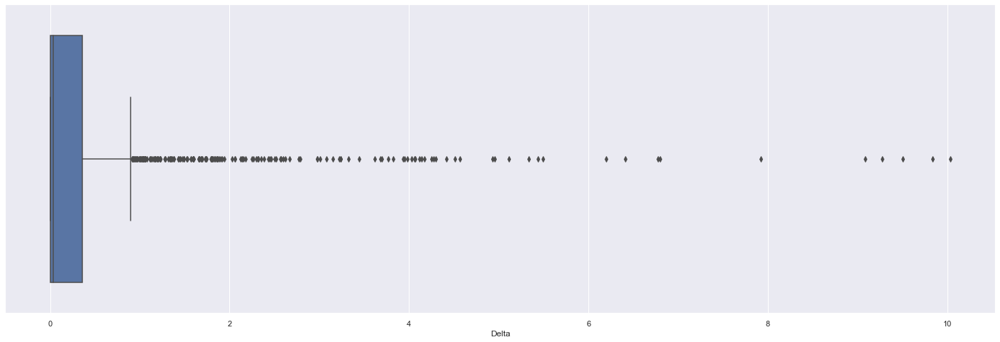

In [72]:
plt.figure(figsize=(25,8))
sns.boxplot(x=words_deltas['Delta'])

In [73]:
z = np.abs(stats.zscore(words_deltas['Delta']))
threshold = 1
print(np.where(z > threshold))

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102],
      dtype=int64),)


In [74]:
outliers_index = [  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102]

In [75]:
for outlier in outliers_index:
    print(words_deltas['word'].iloc[outlier])

coarsened
apparent
multisegmental-sized
scapular
local
gas-containing
subacute
ninth
well-defined
multilevel
asymmetrically
transcatheter
double
minimal
iatrogenic
withdrawing
temperature
erosion
finding
questionable
hiding
pericardial
pneumomediastinum
small-moderate
aneurysm
neuro
massively
densely
radiodensities
denser
ovoid
protheses
band-like
box
multilobar
i
notice
veiling
radiographic
sixth
incidental
reasonable
scattered
nasal
similar
containing
smaller
deformity
prominence
question
lymphangitic
adult
there
one
coarse
free
possible
flattening
patient's
iabp
defibrillating
widened
seventh
comminuted
presumed
additionally
subsegmental-sized
valvular
probable
subtle
strong
leftward
abrupt
lobulated
additional
nodular
mild
faint
heterogeneous
severe
radiopaque
tortuosity
substantial
diffuse
slight
paucity
partial
generator
s-shaped
multiple
patchy
remote
high-density
except
layering
anterior-lateral
no
this
borderline
densities
about
percutaneous
stimulating


### Topical Model

In [76]:
stop_words = stopwords.words('english')
stop_words.extend(['in', 'the', 'of', 'or', 'and', 'a', 'at', 'there', 'which', 'with', 'but', 'image', 'due', 'to', 'wa'])
#Stayed is, no, are,

data_list_tokenize = []
for s in audio_transcripts:
  word_token = word_tokenize(s)
  new_sentence = []
  for word in word_token:
    if (not word in stop_words):
      new_sentence.append(word)
  data_list_tokenize.append(new_sentence)

bigram = gensim.models.Phrases(data_list_tokenize, min_count=2, threshold=100)
bigram_mod = gensim.models.phrases.Phraser(bigram)

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

bigrams = make_bigrams(data_list_tokenize)

lemmatizer = WordNetLemmatizer()

lemmatized_bigrams = []
for tokens in  bigrams:
  temp_lemma = []
  for token in tokens:
    temp_lemma.append( lemmatizer.lemmatize(token) )
  temp_lemma.sort()
  lemmatized_bigrams.append(temp_lemma)
  
print(lemmatized_bigrams[0:10])


[['abnormality', 'acute', 'atelectasis', 'bibasilar', 'effusion', 'heart', 'mild', 'normal', 'osseous', 'pneumothorax', 'pulmonary', 'vessel'], ['abnormality', 'acute', 'adjacent', 'aortic', 'atelectasis', 'basal', 'cardiomegaly', 'combination', 'fluid', 'hemithorax', 'intact', 'left', 'likely', 'lung', 'marked', 'mechanical', 'opacity', 'osseous', 'pleural', 'present', 'present', 'present', 'sternal', 'valve', 'wire'], ['apparatus', 'atelectasis', 'bibasilar', 'cardiac', 'limit', 'normal', 'pneumothorax', 'probable', 'silhouette', 'size', 'support', 'upper'], ['abnormality', 'acute', 'atelectasis', 'base', 'cardiac', 'clip', 'enlarged', 'fluid', 'hardware', 'layering', 'lung', 'may', 'mediastinal', 'multiple', 'opacity', 'osseous', 'partially', 'pleural', 'pneumothorax', 'represent', 'silhouette', 'spinal_fixation', 'sternotomy', 'surgical', 'thoracolumbar', 'visualized', 'visualized', 'wire'], ['acute', 'atelectasis', 'base', 'cardiomegaly', 'consolidation', 'could', 'effusion', 'exa

In [77]:
id2word = corpora.Dictionary(lemmatized_bigrams)

texts = lemmatized_bigrams
corpus = [id2word.doc2bow(text) for text in texts]

print(corpus[0:10])

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1)], [(0, 1), (1, 1), (2, 1), (8, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 1), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 3), (28, 1), (29, 1), (30, 1)], [(2, 1), (3, 1), (7, 1), (9, 1), (31, 1), (32, 1), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 1)], [(0, 1), (1, 1), (2, 1), (8, 1), (9, 1), (17, 1), (22, 1), (25, 1), (26, 1), (30, 1), (32, 1), (35, 1), (39, 1), (40, 1), (41, 1), (42, 1), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 2)], [(1, 1), (2, 1), (4, 1), (8, 1), (15, 1), (22, 1), (25, 1), (26, 1), (39, 1), (48, 1), (52, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1), (60, 1), (61, 1), (62, 2), (63, 1), (64, 1), (65, 1), (66, 1)], [(0, 1), (1, 1), (2, 2), (4, 1), (6, 1), (8, 1), (9, 1), (20, 1), (25, 1), (26, 1), (44, 1), (48, 1), (54, 1), (61, 2), (63, 1), (67, 

In [78]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
          model =gensim.models.ldamodel.LdaModel(corpus=corpus, id2word=id2word,
                                                num_topics=num_topics, random_state=100,
                                                update_every=1, chunksize=100,
                                                passes=10, alpha='auto',
                                                per_word_topics=True)    
          model_list.append(model)
          coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
          coherence_values.append(coherencemodel.get_coherence())
          
    return model_list, coherence_values

In [79]:
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, 
                                                        texts=lemmatized_bigrams, start=1, limit=40, step=5)

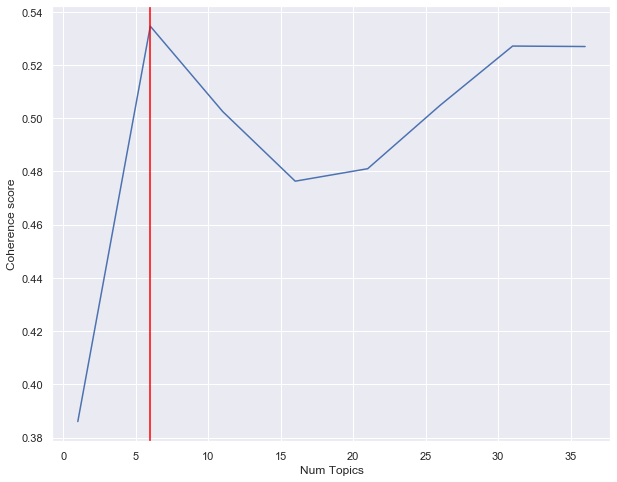

In [80]:
limit=40
start=1
step=5
x = range(start, limit, step)
plt.figure(figsize=(10,8))
plt.plot(x, coherence_values)
plt.axvline(x=6, color='red')
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.show()

In [81]:
# Print the coherence scores
OPTIMAL_TOPICS = 0
max_cv = round( np.max(coherence_values), 4)

for m, cv in zip(x, coherence_values):
  if( round(cv, 4) == max_cv ):
    OPTIMAL_TOPICS = m
  print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

print("\nThe optimum number of topics is %i\n" %OPTIMAL_TOPICS)

Num Topics = 1  has Coherence Value of 0.386
Num Topics = 6  has Coherence Value of 0.5346
Num Topics = 11  has Coherence Value of 0.5025
Num Topics = 16  has Coherence Value of 0.4763
Num Topics = 21  has Coherence Value of 0.481
Num Topics = 26  has Coherence Value of 0.5049
Num Topics = 31  has Coherence Value of 0.5271
Num Topics = 36  has Coherence Value of 0.5269

The optimum number of topics is 6



### LDA Model

In [82]:
OPTIMAL_TOPICS = 6
#Experimentar valores diferentes

In [83]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=OPTIMAL_TOPICS, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

### View the topics in LDA model

In [84]:
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.186*"present" + 0.069*"abnormality" + 0.065*"normal" + 0.060*"pleural" + '
  '0.051*"osseous" + 0.043*"space" + 0.041*"mediastinal" + 0.039*"contour" + '
  '0.038*"pulmonary" + 0.036*"cardiac"'),
 (1,
  '0.091*"right" + 0.084*"left" + 0.042*"catheter" + 0.042*"tip" + '
  '0.034*"tube" + 0.030*"upper" + 0.030*"project" + 0.024*"small" + '
  '0.023*"lower" + 0.019*"svc"'),
 (2,
  '0.068*"normal" + 0.053*"lung" + 0.048*"volume" + 0.048*"limit" + '
  '0.045*"within" + 0.043*"size" + 0.040*"mediastinal" + 0.040*"abnormality" + '
  '0.040*"pneumothorax" + 0.039*"acute"'),
 (3,
  '0.087*"right" + 0.059*"left" + 0.037*"wire" + 0.036*"rib" + '
  '0.030*"fracture" + 0.030*"sternotomy" + 0.029*"intact" + 0.023*"lead" + '
  '0.020*"device" + 0.019*"pectoral"'),
 (4,
  '0.131*"tube" + 0.104*"acute" + 0.074*"positioned" + 0.057*"osseous" + '
  '0.057*"finding" + 0.056*"endotracheal" + 0.054*"stomach" + '
  '0.053*"abnormality" + 0.047*"gastric" + 0.037*"well"'),
 (5,
  '0.067*"pneumothorax

In [85]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=lemmatized_bigrams, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -4.898363494392495

Coherence Score:  0.5345875372912036


### Visualize the topics-keywords

In [86]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_lda.corpus, id2word, mds='mmds')
vis

C:\Users\User\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5     -0.090101  0.077212       1        1  41.240485
1     -0.099427 -0.331931       2        1  17.203098
2     -0.296015  0.031032       3        1  15.286034
0     -0.114463  0.319887       4        1  14.216904
3      0.274914 -0.290866       5        1   8.138246
4      0.325092  0.194665       6        1   3.915233, topic_info=            Term         Freq        Total Category  logprob  loglift
27       present  1660.000000  1660.000000  Default  30.0000  30.0000
1          acute  2196.000000  2196.000000  Default  29.0000  29.0000
61         right  1822.000000  1822.000000  Default  28.0000  28.0000
79          tube   685.000000   685.000000  Default  27.0000  27.0000
0    abnormality  2300.000000  2300.000000  Default  26.0000  26.0000
..           ...          ...          ...      ...      ...      ...
8        osseous   140.524491  2155.494751   Topic6  -2.8609   0.5099
0    abnormality   130.752521  2300.798100   Topic6  -2.9330   0.3726
601        focal     8.565422    15.914847   Topic6  -5.6586   2.6208
165  parenchymal    10.952098   274.601425   Topic6  -5.4128   0.0185
36          size    11.277840   637.137024   Topic6  -5.3835  -0.7938

[321 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
324       2  0.991450      abdomen
0         1  0.495915  abnormality
0         2  0.012604  abnormality
0         3  0.167768  abnormality
0         4  0.266429  abnormality
...     ...       ...          ...
30        4  0.182695         wire
30        5  0.813426         wire
139       2  0.100169       within
139       3  0.897349       within
213       4  0.968292         zone

[364 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 2, 3, 1, 4, 5])

In [87]:
vis.topic_info

,Term,Freq,Total,Category,logprob,loglift
27,present,1660.000000,1660.000000,Default,30.0000,30.0000
1,acute,2196.000000,2196.000000,Default,29.0000,29.0000
61,right,1822.000000,1822.000000,Default,28.0000,28.0000
79,tube,685.000000,685.000000,Default,27.0000,27.0000
0,abnormality,2300.000000,2300.000000,Default,26.0000,26.0000
...,...,...,...,...,...,...
8,osseous,140.524491,2155.494751,Topic6,-2.8609,0.5099
0,abnormality,130.752521,2300.798100,Topic6,-2.9330,0.3726
601,focal,8.565422,15.914847,Topic6,-5.6586,2.6208
165,parenchymal,10.952098,274.601425,Topic6,-5.4128,0.0185


### Identificar Outputs mais frequentes

In [88]:
import os.path
outputs_ellipses_df = pd.DataFrame()

for i in range(len(patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(patients_id[i])+'\REFLACX\P'+str(exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i, ' of', len(patients_id))
    for file in os.listdir():
        if file.endswith("anomaly_location_ellipses.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                outputs_ellipses_df = pd.concat([outputs_ellipses_df, aux_df], axis=0)

Search Number:  0  of 3052
Search Number:  1  of 3052
Search Number:  2  of 3052
Search Number:  3  of 3052
Search Number:  4  of 3052
Search Number:  5  of 3052
Search Number:  6  of 3052
Search Number:  7  of 3052
Search Number:  8  of 3052
Search Number:  9  of 3052
Search Number:  10  of 3052
Search Number:  11  of 3052
Search Number:  12  of 3052
Search Number:  13  of 3052
Search Number:  14  of 3052
Search Number:  15  of 3052
Search Number:  16  of 3052
Search Number:  17  of 3052
Search Number:  18  of 3052
Search Number:  19  of 3052
Search Number:  20  of 3052
Search Number:  21  of 3052
Search Number:  22  of 3052
Search Number:  23  of 3052
Search Number:  24  of 3052
Search Number:  25  of 3052
Search Number:  26  of 3052
Search Number:  27  of 3052
Search Number:  28  of 3052
Search Number:  29  of 3052
Search Number:  30  of 3052
Search Number:  31  of 3052
Search Number:  32  of 3052
Search Number:  33  of 3052
Search Number:  34  of 3052
Search Number:  35  of 3052
Se

In [89]:
outputs_ellipses_df.head(3)

,xmin,ymin,xmax,ymax,certainty,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,patient_id,exam_id,dicom_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,734,1204,2211,2175,5,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,831,1204,2223,2310,5,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R379837,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,357,1224,1006,2242,4,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R558314,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [90]:
outputs_ellipses_df.drop(['xmin', 'ymin', 'xmax', 'ymax', 'certainty', 'patient_id', 'dicom_id'], inplace=True, axis=1)
outputs_ellipses_df.reset_index(inplace=True, drop=True)
outputs_ellipses_df.head(3)

,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,exam_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,P102R108387,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,P102R379837,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,P102R558314,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [91]:
columns_names = outputs_ellipses_df.columns.to_list()

In [92]:
outputs_ellipses_df.isna().sum()

Airway wall thickening          4519
Atelectasis                        0
Consolidation                      0
Emphysema                       4519
Enlarged cardiac silhouette        0
Fibrosis                        4519
Fracture                        4519
Groundglass opacity                0
Mass                            4519
Nodule                          4519
Other                              0
Pleural effusion                4519
Pleural thickening              4519
Pneumothorax                       0
Pulmonary edema                    0
Quality issue                   4519
Support devices                    0
Wide mediastinum                4519
exam_id                            0
Abnormal mediastinal contour     569
Acute fracture                   569
Enlarged hilum                   569
Hiatal hernia                    569
High lung volume / emphysema     569
Interstitial lung disease        569
Lung nodule or mass              569
Pleural abnormality              569
d

#### Conclusion

The outputs Atelectasis, Consolidation, Enlarged cardiac silhouette, Groundglass opacity, Pneumothorax and Pulmonary edema are the ones that always have labels.

The outputs Airway wall thickening, Emphysema, Fibrosis, Fracture, Mass, Nodule, Pleural effusion, Pleural Thickening, Quality issue, Wide Mediastinum have too much NaN values to be studied

The rest of the outputs have to be evaluated if they have sufficient different values to study

In [93]:
for i in range(26):
    if i == 18:
        continue
    else:
        print(outputs_ellipses_df[columns_names[i]].value_counts())

False    533
True      36
Name: Airway wall thickening, dtype: int64
False    3887
True     1201
Name: Atelectasis, dtype: int64
False    3926
True     1162
Name: Consolidation, dtype: int64
False    556
True      13
Name: Emphysema, dtype: int64
False    4372
True      716
Name: Enlarged cardiac silhouette, dtype: int64
False    558
True      11
Name: Fibrosis, dtype: int64
False    551
True      18
Name: Fracture, dtype: int64
False    4492
True      596
Name: Groundglass opacity, dtype: int64
False    566
True       3
Name: Mass, dtype: int64
False    545
True      24
Name: Nodule, dtype: int64
False    5061
True       27
Name: Other, dtype: int64
False    455
True     114
Name: Pleural effusion, dtype: int64
False    562
True       7
Name: Pleural thickening, dtype: int64
False    4966
True      122
Name: Pneumothorax, dtype: int64
False    4322
True      766
Name: Pulmonary edema, dtype: int64
False    569
Name: Quality issue, dtype: int64
False    5088
Name: Support devices, dtyp

### Correlation between outputs and transcripts

In [94]:
pneumothorax_true_df = outputs_ellipses_df.loc[outputs_ellipses_df['Pneumothorax'] == True]
pneumothorax_true_df.head(3)

,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,exam_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
103,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,P114R310875,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
105,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,P114R685469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
108,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,P114R770641,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [95]:
pneum_dicom_ids_true = pneumothorax_true_df['exam_id'].to_list()

In [96]:
pneum_true_transc_df = pd.DataFrame()

for i in range(len(transcripts_timestamps)):
    if transcripts_timestamps['exam_id'].iloc[i] in pneum_dicom_ids_true:
        aux_df = pd.DataFrame(transcripts_timestamps.iloc[i]).T
        aux_df.drop('index', axis=1)
        pneum_true_transc_df = pd.concat([pneum_true_transc_df, aux_df], axis=0)

In [97]:
pneum_true_transc_df

,index,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id,Delta
1918,0,support,3.67,4.25,13716770,P114R310875,4a5f103e-ebe88274-8f7358da-9c31c697-f91c88f1,3.67
1919,1,apparatus,4.25,5.0,13716770,P114R310875,4a5f103e-ebe88274-8f7358da-9c31c697-f91c88f1,0.0
1920,2,.,5.0,5.56,13716770,P114R310875,4a5f103e-ebe88274-8f7358da-9c31c697-f91c88f1,0.56
1921,3,probable,8.0,8.47,13716770,P114R310875,4a5f103e-ebe88274-8f7358da-9c31c697-f91c88f1,2.44
1922,4,trace,8.47,9.15,13716770,P114R310875,4a5f103e-ebe88274-8f7358da-9c31c697-f91c88f1,0.0
...,...,...,...,...,...,...,...,...
103340,28,no,43.56,43.89,19991135,P300R336111,d04bbcbd-5143439e-50ebe9a8-71380f67-44f8d127,7.8
103341,29,acute,43.89,44.22,19991135,P300R336111,d04bbcbd-5143439e-50ebe9a8-71380f67-44f8d127,0.0
103342,30,osseous,44.22,44.62,19991135,P300R336111,d04bbcbd-5143439e-50ebe9a8-71380f67-44f8d127,0.0
103343,31,abnormality,44.62,45.14,19991135,P300R336111,d04bbcbd-5143439e-50ebe9a8-71380f67-44f8d127,0.0


In [98]:
words_pneum_true = pneum_true_transc_df['word'].to_list()

In [99]:
# initializing punctuations string
punc = '''!()-[]{};:'" \,<>./?@#$%^&*_~'''
 
# Removing punctuations in string
# Using loop + punctuation string
for i in range(len(words_pneum_true)):
    ele = words_pneum_true[i]
    if ele in punc:
        words_pneum_true[i] = words_pneum_true[i].replace(ele, "")

In [100]:
words_dict = dict()


for line in words_pneum_true:
    line = line.strip()
    line = line.lower()

    words = line.split(" ")
  
    
    for word in words:
        if word == "":
            continue
        if word in words_dict:
            words_dict[word] = words_dict[word] + 1
        else:
            words_dict[word] = 1

words_count_df = pd.DataFrame(list(words_dict.items()))

In [101]:
words_count_df.sort_values(1, ascending=False).head(15)

,0,1
27,the,217
4,right,215
7,is,189
28,left,163
23,pleural,109
9,no,107
78,present,103
19,in,96
22,small,85
5,pneumothorax,83


In [102]:
t2w = transcripts2words()
bigram_df = t2w.bigram(words_pneum_true)
trigram_df = t2w.trigram(words_pneum_true)
quadgram_df = t2w.quadgram(words_pneum_true)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     1603
Trigram    |     2575
Quadgram   |     3213


In [103]:
df1_styler = bigram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Bigram')
df2_styler = trigram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Trigram')
df3_styler = quadgram_df.head(10).style.set_table_attributes("style='display:inline'").set_caption('Quadgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('in', 'the')",77
1,"('is', 'present')",62
2,"('acute', 'osseous')",61
3,"('no', 'acute')",59
4,"('osseous', 'abnormality')",58
5,"('the', 'right')",45
6,"('there', 'is')",44
7,"('pleural', 'effusion')",43
8,"('the', 'left')",42
9,"('apical', 'pneumothorax')",34


### Calculation of mean and standard deviation of the time used for each word

In [104]:
words_set = set()
dict_keys = []
dict_values = []

for i in range(len(words_transcripts_timestamps)):
    word = words_transcripts_timestamps.iloc[i,1]
    if word not in words_set:
        words_set.add(word)
        df = pd.DataFrame(words_transcripts_timestamps.loc[words_transcripts_timestamps['word'] == word]['Delta'])
        mean = df['Delta'].mean()
        std_dev = df['Delta'].std(ddof=0)
        dict_keys.append(word)
        dict_values.append([mean, std_dev])
    else:
        continue

In [105]:
words_statistics_dict = { dict_keys[i] : dict_values[i] for i in range(len(dict_keys)) }

In [106]:
words_statistics_df = pd.DataFrame.from_dict(words_statistics_dict, orient=('index'))

In [107]:
words_statistics_df

,0,1
apparatus,0.005296,0.046161
no,1.652491,2.784562
pneumothorax,0.016222,0.179062
enlarged,0.583060,1.432152
cardiac,0.933542,1.864026
...,...,...
protheses,3.820000,0.000000
chronicity,1.490000,0.000000
interior,0.000000,0.000000
overinflated,0.000000,0.000000


In [108]:
df1_styler = words_statistics_df.sort_values(by=0, ascending=False).head(15).style.set_table_attributes("style='display:inline'").set_caption('Sorted by mean')
df2_styler = words_statistics_df.sort_values(by=1, ascending=False).head(15).style.set_table_attributes("style='display:inline'").set_caption('Sorted by Standard Deviation')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_(), raw=True)

,0,1
coarsened,10.030000,0.000000
apparent,9.830000,0.000000
multisegmental-sized,9.500000,0.000000
scapular,9.270000,0.000000
local,9.080000,0.000000
gas-containing,7.920000,0.000000
subacute,6.800000,0.000000
ninth,6.770000,0.000000
well-defined,6.410000,0.000000
multilevel,6.195000,6.195000


In [109]:
words_statistics_df.reset_index(inplace=True)

In [110]:
words_statistics_df['Frequency'] = 0
for i in range(len(words_statistics_df)):
    if words_statistics_df['index'].iloc[i] in words_dict.keys():
        words_statistics_df['Frequency'].iloc[i] = words_dict[words_statistics_df['index'].iloc[i]]+1
    else:
        words_statistics_df['Frequency'].iloc[i] = 1

C:\Users\User\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [111]:
words_statistics_df

,index,0,1,Frequency
0,apparatus,0.005296,0.046161,11
1,no,1.652491,2.784562,108
2,pneumothorax,0.016222,0.179062,84
3,enlarged,0.583060,1.432152,9
4,cardiac,0.933542,1.864026,25
...,...,...,...,...
1178,protheses,3.820000,0.000000,1
1179,chronicity,1.490000,0.000000,1
1180,interior,0.000000,0.000000,1
1181,overinflated,0.000000,0.000000,1


### Analysis of all false outputs cases

In [112]:
outputs_ellipses_df = pd.DataFrame()

for i in range(len(patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(patients_id[i])+'\REFLACX\P'+str(exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i, ' of', len(patients_id))
    for file in os.listdir():
        if file.endswith("anomaly_location_ellipses.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                outputs_ellipses_df = pd.concat([outputs_ellipses_df, aux_df], axis=0)

Search Number:  0  of 3052
Search Number:  1  of 3052
Search Number:  2  of 3052
Search Number:  3  of 3052
Search Number:  4  of 3052
Search Number:  5  of 3052
Search Number:  6  of 3052
Search Number:  7  of 3052
Search Number:  8  of 3052
Search Number:  9  of 3052
Search Number:  10  of 3052
Search Number:  11  of 3052
Search Number:  12  of 3052
Search Number:  13  of 3052
Search Number:  14  of 3052
Search Number:  15  of 3052
Search Number:  16  of 3052
Search Number:  17  of 3052
Search Number:  18  of 3052
Search Number:  19  of 3052
Search Number:  20  of 3052
Search Number:  21  of 3052
Search Number:  22  of 3052
Search Number:  23  of 3052
Search Number:  24  of 3052
Search Number:  25  of 3052
Search Number:  26  of 3052
Search Number:  27  of 3052
Search Number:  28  of 3052
Search Number:  29  of 3052
Search Number:  30  of 3052
Search Number:  31  of 3052
Search Number:  32  of 3052
Search Number:  33  of 3052
Search Number:  34  of 3052
Search Number:  35  of 3052
Se

In [113]:
outputs_ellipses_df.reset_index(drop=True, inplace=True)

In [114]:
outputs_ellipses_df.head(2)

,xmin,ymin,xmax,ymax,certainty,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,patient_id,exam_id,dicom_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,734,1204,2211,2175,5,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,831,1204,2223,2310,5,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R379837,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [115]:
outputs_ellipses_df.fillna(False, inplace=True)

In [116]:
aux_df = pd.DataFrame(outputs_ellipses_df.loc[0]).T
aux_df

,xmin,ymin,xmax,ymax,certainty,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,patient_id,exam_id,dicom_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,734,1204,2211,2175,5.0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False


In [117]:
all_false_outputs_df = pd.DataFrame()

for i in range(len(outputs_ellipses_df)):
    count = 0
    for j in range(len(outputs_ellipses_df.columns.tolist())):
        if outputs_ellipses_df.iloc[i,j] == False:
            count +=1
    print(count, '/26')
    if count == 25:
        aux_df = pd.DataFrame(outputs_ellipses_df.loc[i]).T
        all_false_outputs_df = pd.concat([all_false_outputs_df, aux_df], axis=0)

25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
23 /26
25 /26
24 /26
24 /26
24 /26
24 /26
24 /26
24 /26
24 /26
24 /26
24 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
24 /26
25 /26
25 /26
23 /26
23 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
23 /26
23 /26
25 /26
24 /26
25 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
23 /26
25 /26
25 /26
25 /26
24 /26
24 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
25 /26
24 /26
24 /26
24 /26
24 /26
25 /26
25 /26
25 /26
25 /26

In [118]:
all_false_outputs_df

,xmin,ymin,xmax,ymax,certainty,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,patient_id,exam_id,dicom_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,734,1204,2211,2175,5.0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False
1,831,1204,2223,2310,5.0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R379837,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False
2,357,1224,1006,2242,4.0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R558314,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False
3,692,1364,2257,2261,5.0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R558314,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False
4,451,2114,579,2240,1.0,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,18111516,P102R765317,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5078,175,165,808,811,5.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,19991135,P300R331925,d8f5555c-d8bcf97c-3a9d5596-17b9f854-6e15d081,False,False,False,False,False,False,False,True
5080,485,448,1288,1252,5.0,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,19991135,P300R336111,d04bbcbd-5143439e-50ebe9a8-71380f67-44f8d127,False,False,False,False,False,False,False,False
5083,1339,1197,1977,1597,5.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,19997367,P300R179177,7cfe7acc-65b0b548-feb77772-04c46d33-76a03230,False,False,False,False,False,False,False,True
5084,68,1246,709,1504,5.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,19997367,P300R179177,7cfe7acc-65b0b548-feb77772-04c46d33-76a03230,False,False,False,False,False,False,False,True


In [119]:
all_false_outputs_df_c5 = all_false_outputs_df.loc[all_false_outputs_df['certainty'] == 5]
all_false_outputs_df_c5.head(1)

,xmin,ymin,xmax,ymax,certainty,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,patient_id,exam_id,dicom_id,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,734,1204,2211,2175,5.0,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,False,False,False,False,False,False,False,False


In [120]:
atelectasis_true = all_false_outputs_df.loc[all_false_outputs_df['Atelectasis'] == True]
consolidation_true = all_false_outputs_df.loc[all_false_outputs_df['Consolidation'] == True]
ecs_true = all_false_outputs_df.loc[all_false_outputs_df['Enlarged cardiac silhouette'] == True]
ggo_true = all_false_outputs_df.loc[all_false_outputs_df['Groundglass opacity'] == True]
pneumothorax_true = all_false_outputs_df.loc[all_false_outputs_df['Pneumothorax'] == True]
pulmonary_edema_true = all_false_outputs_df.loc[all_false_outputs_df['Pulmonary edema'] == True]

In [121]:
print('Size   |  Output')
print('_______|____________________________')
print(len(atelectasis_true), '   |  ', 'Atelectasis')
print(len(consolidation_true), '   |  ', 'Consolidation')
print(len(ecs_true), '   |  ', 'Enlarged Cardiac Silhouette')
print(len(ggo_true), '   |  ', 'Ground Glass Opacity')
print(len(pneumothorax_true), '   |  ', 'Pneumothorax')
print(len(pulmonary_edema_true), '   |  ', 'Pulmonary Edema')
print('_______|____________________________')
print(len(atelectasis_true)+len(consolidation_true)+len(ecs_true)+len(ggo_true)+len(pneumothorax_true)+len(pulmonary_edema_true), '  |  ', 'Total')

Size   |  Output
_______|____________________________
407    |   Atelectasis
353    |   Consolidation
714    |   Enlarged Cardiac Silhouette
182    |   Ground Glass Opacity
109    |   Pneumothorax
433    |   Pulmonary Edema
_______|____________________________
2198   |   Total


### Analysis of the 6 outputs keywords

#### Importing the transcripts from each 6 specific outputs exams

In [122]:
atelectasis_patients = atelectasis_true['patient_id'].tolist()
atelectasis_exams = atelectasis_true['exam_id'].tolist()
consolidation_patients = consolidation_true['patient_id'].tolist()
consolidation_exams = consolidation_true['exam_id'].tolist()
ecs_patients = ecs_true['patient_id'].tolist()
ecs_exams = ecs_true['exam_id'].tolist()
ggo_patients = ggo_true['patient_id'].tolist()
ggo_exams = ggo_true['exam_id'].tolist()
pneumothorax_patients = pneumothorax_true['patient_id'].tolist()
pneumothorax_exams = pneumothorax_true['exam_id'].tolist()
pulmonary_edema_patients = pulmonary_edema_true['patient_id'].tolist()
pulmonary_edema_exams = pulmonary_edema_true['exam_id'].tolist()

In [123]:
atelectasis_scripts_df = pd.DataFrame()

for i in range(len(atelectasis_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(atelectasis_patients[i])+'\REFLACX\P'+str(atelectasis_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(atelectasis_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                atelectasis_scripts_df = pd.concat([atelectasis_scripts_df, aux_df], axis=0)

Search Number:  1  of 407
Search Number:  2  of 407
Search Number:  3  of 407
Search Number:  4  of 407
Search Number:  5  of 407
Search Number:  6  of 407
Search Number:  7  of 407
Search Number:  8  of 407
Search Number:  9  of 407
Search Number:  10  of 407
Search Number:  11  of 407
Search Number:  12  of 407
Search Number:  13  of 407
Search Number:  14  of 407
Search Number:  15  of 407
Search Number:  16  of 407
Search Number:  17  of 407
Search Number:  18  of 407
Search Number:  19  of 407
Search Number:  20  of 407
Search Number:  21  of 407
Search Number:  22  of 407
Search Number:  23  of 407
Search Number:  24  of 407
Search Number:  25  of 407
Search Number:  26  of 407
Search Number:  27  of 407
Search Number:  28  of 407
Search Number:  29  of 407
Search Number:  30  of 407
Search Number:  31  of 407
Search Number:  32  of 407
Search Number:  33  of 407
Search Number:  34  of 407
Search Number:  35  of 407
Search Number:  36  of 407
Search Number:  37  of 407
Search Num

In [124]:
consolidation_scripts_df = pd.DataFrame()

for i in range(len(consolidation_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(consolidation_patients[i])+'\REFLACX\P'+str(consolidation_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(consolidation_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                consolidation_scripts_df = pd.concat([consolidation_scripts_df, aux_df], axis=0)

Search Number:  1  of 353
Search Number:  2  of 353
Search Number:  3  of 353
Search Number:  4  of 353
Search Number:  5  of 353
Search Number:  6  of 353
Search Number:  7  of 353
Search Number:  8  of 353
Search Number:  9  of 353
Search Number:  10  of 353
Search Number:  11  of 353
Search Number:  12  of 353
Search Number:  13  of 353
Search Number:  14  of 353
Search Number:  15  of 353
Search Number:  16  of 353
Search Number:  17  of 353
Search Number:  18  of 353
Search Number:  19  of 353
Search Number:  20  of 353
Search Number:  21  of 353
Search Number:  22  of 353
Search Number:  23  of 353
Search Number:  24  of 353
Search Number:  25  of 353
Search Number:  26  of 353
Search Number:  27  of 353
Search Number:  28  of 353
Search Number:  29  of 353
Search Number:  30  of 353
Search Number:  31  of 353
Search Number:  32  of 353
Search Number:  33  of 353
Search Number:  34  of 353
Search Number:  35  of 353
Search Number:  36  of 353
Search Number:  37  of 353
Search Num

In [125]:
ecs_scripts_df = pd.DataFrame()

for i in range(len(ecs_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(ecs_patients[i])+'\REFLACX\P'+str(ecs_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(ecs_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                ecs_scripts_df = pd.concat([ecs_scripts_df, aux_df], axis=0)

Search Number:  1  of 714
Search Number:  2  of 714
Search Number:  3  of 714
Search Number:  4  of 714
Search Number:  5  of 714
Search Number:  6  of 714
Search Number:  7  of 714
Search Number:  8  of 714
Search Number:  9  of 714
Search Number:  10  of 714
Search Number:  11  of 714
Search Number:  12  of 714
Search Number:  13  of 714
Search Number:  14  of 714
Search Number:  15  of 714
Search Number:  16  of 714
Search Number:  17  of 714
Search Number:  18  of 714
Search Number:  19  of 714
Search Number:  20  of 714
Search Number:  21  of 714
Search Number:  22  of 714
Search Number:  23  of 714
Search Number:  24  of 714
Search Number:  25  of 714
Search Number:  26  of 714
Search Number:  27  of 714
Search Number:  28  of 714
Search Number:  29  of 714
Search Number:  30  of 714
Search Number:  31  of 714
Search Number:  32  of 714
Search Number:  33  of 714
Search Number:  34  of 714
Search Number:  35  of 714
Search Number:  36  of 714
Search Number:  37  of 714
Search Num

In [126]:
ggo_scripts_df = pd.DataFrame()

for i in range(len(ggo_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(ggo_patients[i])+'\REFLACX\P'+str(ggo_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(ggo_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                ggo_scripts_df = pd.concat([ggo_scripts_df, aux_df], axis=0)

Search Number:  1  of 182
Search Number:  2  of 182
Search Number:  3  of 182
Search Number:  4  of 182
Search Number:  5  of 182
Search Number:  6  of 182
Search Number:  7  of 182
Search Number:  8  of 182
Search Number:  9  of 182
Search Number:  10  of 182
Search Number:  11  of 182
Search Number:  12  of 182
Search Number:  13  of 182
Search Number:  14  of 182
Search Number:  15  of 182
Search Number:  16  of 182
Search Number:  17  of 182
Search Number:  18  of 182
Search Number:  19  of 182
Search Number:  20  of 182
Search Number:  21  of 182
Search Number:  22  of 182
Search Number:  23  of 182
Search Number:  24  of 182
Search Number:  25  of 182
Search Number:  26  of 182
Search Number:  27  of 182
Search Number:  28  of 182
Search Number:  29  of 182
Search Number:  30  of 182
Search Number:  31  of 182
Search Number:  32  of 182
Search Number:  33  of 182
Search Number:  34  of 182
Search Number:  35  of 182
Search Number:  36  of 182
Search Number:  37  of 182
Search Num

In [127]:
pneumothorax_scripts_df = pd.DataFrame()

for i in range(len(pneumothorax_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(pneumothorax_patients[i])+'\REFLACX\P'+str(pneumothorax_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(pneumothorax_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                pneumothorax_scripts_df = pd.concat([pneumothorax_scripts_df, aux_df], axis=0)

Search Number:  1  of 109
Search Number:  2  of 109
Search Number:  3  of 109
Search Number:  4  of 109
Search Number:  5  of 109
Search Number:  6  of 109
Search Number:  7  of 109
Search Number:  8  of 109
Search Number:  9  of 109
Search Number:  10  of 109
Search Number:  11  of 109
Search Number:  12  of 109
Search Number:  13  of 109
Search Number:  14  of 109
Search Number:  15  of 109
Search Number:  16  of 109
Search Number:  17  of 109
Search Number:  18  of 109
Search Number:  19  of 109
Search Number:  20  of 109
Search Number:  21  of 109
Search Number:  22  of 109
Search Number:  23  of 109
Search Number:  24  of 109
Search Number:  25  of 109
Search Number:  26  of 109
Search Number:  27  of 109
Search Number:  28  of 109
Search Number:  29  of 109
Search Number:  30  of 109
Search Number:  31  of 109
Search Number:  32  of 109
Search Number:  33  of 109
Search Number:  34  of 109
Search Number:  35  of 109
Search Number:  36  of 109
Search Number:  37  of 109
Search Num

In [128]:
pulmonary_edema_scripts_df = pd.DataFrame()

for i in range(len(pulmonary_edema_patients)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(pulmonary_edema_patients[i])+'\REFLACX\P'+str(pulmonary_edema_exams[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(pulmonary_edema_patients))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = patients_id[i]
                aux_df['exam_id'] = exams_id[i]
                aux_df['dicom_id'] = dicom_ids[i]
                pulmonary_edema_scripts_df = pd.concat([pulmonary_edema_scripts_df, aux_df], axis=0)

Search Number:  1  of 433
Search Number:  2  of 433
Search Number:  3  of 433
Search Number:  4  of 433
Search Number:  5  of 433
Search Number:  6  of 433
Search Number:  7  of 433
Search Number:  8  of 433
Search Number:  9  of 433
Search Number:  10  of 433
Search Number:  11  of 433
Search Number:  12  of 433
Search Number:  13  of 433
Search Number:  14  of 433
Search Number:  15  of 433
Search Number:  16  of 433
Search Number:  17  of 433
Search Number:  18  of 433
Search Number:  19  of 433
Search Number:  20  of 433
Search Number:  21  of 433
Search Number:  22  of 433
Search Number:  23  of 433
Search Number:  24  of 433
Search Number:  25  of 433
Search Number:  26  of 433
Search Number:  27  of 433
Search Number:  28  of 433
Search Number:  29  of 433
Search Number:  30  of 433
Search Number:  31  of 433
Search Number:  32  of 433
Search Number:  33  of 433
Search Number:  34  of 433
Search Number:  35  of 433
Search Number:  36  of 433
Search Number:  37  of 433
Search Num

#### Counting the most common words

In [129]:
atelectasis_scripts_df['Count']=1
consolidation_scripts_df['Count']=1
ecs_scripts_df['Count']=1
ggo_scripts_df['Count']=1
pneumothorax_scripts_df['Count']=1
pulmonary_edema_scripts_df['Count']=1

In [130]:
atelectasis_words_df = pd.DataFrame(atelectasis_scripts_df.groupby('word').count()['Count'])
atelectasis_words_df.reset_index(inplace=True, drop=False)
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != '.']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != ',']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'the']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'is']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'in']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'are']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'and']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'of']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'or']
atelectasis_words_df = atelectasis_words_df.loc[atelectasis_words_df['word'] != 'a']

consolidation_words_df = pd.DataFrame(consolidation_scripts_df.groupby('word').count()['Count'])
consolidation_words_df.reset_index(inplace=True, drop=False)
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != '.']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != ',']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'the']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'is']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'in']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'are']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'and']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'of']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'or']
consolidation_words_df = consolidation_words_df.loc[consolidation_words_df['word'] != 'a']

ecs_words_df = pd.DataFrame(ecs_scripts_df.groupby('word').count()['Count'])
ecs_words_df.reset_index(inplace=True, drop=False)
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != '.']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != ',']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'the']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'is']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'in']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'are']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'and']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'of']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'or']
ecs_words_df = ecs_words_df.loc[ecs_words_df['word'] != 'a']

ggo_words_df = pd.DataFrame(ggo_scripts_df.groupby('word').count()['Count'])
ggo_words_df.reset_index(inplace=True, drop=False)
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != '.']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != ',']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'the']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'is']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'in']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'are']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'and']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'of']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'or']
ggo_words_df = ggo_words_df.loc[ggo_words_df['word'] != 'a']

pneumothorax_words_df = pd.DataFrame(pneumothorax_scripts_df.groupby('word').count()['Count'])
pneumothorax_words_df.reset_index(inplace=True, drop=False)
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != '.']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != ',']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'the']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'is']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'in']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'are']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'and']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'of']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'or']
pneumothorax_words_df = pneumothorax_words_df.loc[pneumothorax_words_df['word'] != 'a']

pulmonary_edema_words_df = pd.DataFrame(pulmonary_edema_scripts_df.groupby('word').count()['Count'])
pulmonary_edema_words_df.reset_index(inplace=True, drop=False)
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != '.']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != ',']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'the']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'is']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'in']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'are']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'and']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'of']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'or']
pulmonary_edema_words_df = pulmonary_edema_words_df.loc[pulmonary_edema_words_df['word'] != 'a']

df1_styler = atelectasis_words_df.sort_values('Count', ascending=False).head(20).style.set_table_attributes("style='display:inline'").set_caption('Atelectasis')
df2_styler = consolidation_words_df.sort_values('Count', ascending=False).head(20).head(20).style.set_table_attributes("style='display:inline'").set_caption('Consolidation')
df3_styler = ecs_words_df.sort_values('Count', ascending=False).head(20).style.set_table_attributes("style='display:inline'").set_caption('Enlarges Cardiac Silhouette')
df4_styler = ggo_words_df.sort_values('Count', ascending=False).head(20).head(20).style.set_table_attributes("style='display:inline'").set_caption('Groundglass Opacity')
df5_styler = pneumothorax_words_df.sort_values('Count', ascending=False).head(20).style.set_table_attributes("style='display:inline'").set_caption('Pneumothorax')
df6_styler = pulmonary_edema_words_df.sort_values('Count', ascending=False).head(20).head(20).style.set_table_attributes("style='display:inline'").set_caption('Pulmonary Edema')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_()+df4_styler._repr_html_()+df5_styler._repr_html_()+df6_styler._repr_html_(), raw=True)

,word,Count
332,no,770
54,atelectasis,412
437,right,363
384,pneumothorax,344
8,acute,330
352,osseous,315
7,abnormality,302
335,normal,294
379,pleural,245
268,left,235


#### N-Grams

In [131]:
stop_words = stopwords.words('english')
stop_words.extend(['.', ',', 'the', 'is', 'in', 'are', 'and', 'of', 'or', 'a'])

##### Atelectasis

In [132]:
atelectasis_ngrams_tokens = atelectasis_scripts_df['word'].tolist()
atelectasis_ngrams = []

for token in atelectasis_ngrams_tokens:
    if (not token in stop_words):
        atelectasis_ngrams.append(token)

In [133]:
t2w = transcripts2words()
bigram_df = t2w.bigram(atelectasis_ngrams)
trigram_df = t2w.trigram(atelectasis_ngrams)
quadgram_df = t2w.quadgram(atelectasis_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     2217
Trigram    |     3704
Quadgram   |     4804


In [134]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Atelectasis Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Atelectasis Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Atelectasis Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('acute', 'osseous')",311
1,"('osseous', 'abnormality')",281
2,"('pneumothorax', 'acute')",154
3,"('pleural', 'effusion')",150
4,"('bibasilar', 'atelectasis')",93
5,"('pulmonary', 'vessels')",91
6,"('vessels', 'normal')",91
7,"('subsegmental', 'atelectasis')",91
8,"('effusions', 'pneumothorax')",88
9,"('basilar', 'atelectasis')",87


##### Consolidation

In [135]:
consolidation_ngrams_tokens = consolidation_scripts_df['word'].tolist()
consolidation_ngrams = []

for token in consolidation_ngrams_tokens:
    if (not token in stop_words):
        consolidation_ngrams.append(token)

t2w = transcripts2words()
bigram_df = t2w.bigram(consolidation_ngrams)
trigram_df = t2w.trigram(consolidation_ngrams)
quadgram_df = t2w.quadgram(consolidation_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     2341
Trigram    |     4017
Quadgram   |     5200


In [136]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Consolidation Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Consolidation Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Consolidation Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('acute', 'osseous')",263
1,"('osseous', 'abnormality')",248
2,"('pleural', 'effusion')",194
3,"('pneumothorax', 'acute')",121
4,"('patchy', 'consolidation')",116
5,"('effusion', 'pneumothorax')",91
6,"('endotracheal', 'tube')",83
7,"('left', 'pleural')",80
8,"('right', 'lung')",80
9,"('right', 'pleural')",70


##### Enlarged Cardiac Silhouette

In [137]:
ecs_ngrams_tokens = ecs_scripts_df['word'].tolist()
ecs_ngrams = []

for token in ecs_ngrams_tokens:
    if (not token in stop_words):
        ecs_ngrams.append(token)

t2w = transcripts2words()
bigram_df = t2w.bigram(ecs_ngrams)
trigram_df = t2w.trigram(ecs_ngrams)
quadgram_df = t2w.quadgram(ecs_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     3671
Trigram    |     6935
Quadgram   |     9520


In [138]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('ECS Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('ECS Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('ECS Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('cardiac', 'silhouette')",443
1,"('acute', 'osseous')",438
2,"('osseous', 'abnormality')",417
3,"('pleural', 'effusion')",279
4,"('pneumothorax', 'acute')",237
5,"('enlarged', 'cardiac')",204
6,"('pulmonary', 'edema')",169
7,"('silhouette', 'enlarged')",157
8,"('support', 'apparatus')",127
9,"('effusion', 'pneumothorax')",125


##### Groundglass Opacity

In [139]:
ggo_ngrams_tokens = ggo_scripts_df['word'].tolist()
ggo_ngrams = []

for token in ggo_ngrams_tokens:
    if (not token in stop_words):
        ggo_ngrams.append(token)

t2w = transcripts2words()
bigram_df = t2w.bigram(ggo_ngrams)
trigram_df = t2w.trigram(ggo_ngrams)
quadgram_df = t2w.quadgram(ggo_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     1455
Trigram    |     2250
Quadgram   |     2798


In [140]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('GGO Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('GGO Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('GGO Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('acute', 'osseous')",141
1,"('osseous', 'abnormality')",136
2,"('pleural', 'effusion')",121
3,"('ground-glass', 'opacities')",81
4,"('pneumothorax', 'acute')",71
5,"('effusion', 'pneumothorax')",66
6,"('right', 'lung')",63
7,"('lung', 'base')",61
8,"('heart', 'size')",57
9,"('within', 'normal')",53


##### Pneumothorax

In [141]:
pneumothorax_ngrams_tokens = pneumothorax_scripts_df['word'].tolist()
pneumothorax_ngrams = []

for token in pneumothorax_ngrams_tokens:
    if (not token in stop_words):
        pneumothorax_ngrams.append(token)

t2w = transcripts2words()
bigram_df = t2w.bigram(pneumothorax_ngrams)
trigram_df = t2w.trigram(pneumothorax_ngrams)
quadgram_df = t2w.quadgram(pneumothorax_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     1273
Trigram    |     2006
Quadgram   |     2397


In [142]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pneumothorax Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pneumothorax Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pneumothorax Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,0,1
0,"('acute', 'osseous')",69
1,"('osseous', 'abnormality')",66
2,"('pleural', 'effusion')",47
3,"('right', 'pleural')",35
4,"('apical', 'pneumothorax')",35
5,"('small', 'right')",32
6,"('right', 'pneumothorax')",25
7,"('pleural', 'space')",24
8,"('small', 'left')",24
9,"('right', 'apical')",23


##### Pulmonary Edema

In [143]:
pulmonary_edema_ngrams_tokens = pulmonary_edema_scripts_df['word'].tolist()
pulmonary_edema_ngrams = []

for token in pulmonary_edema_ngrams_tokens:
    if (not token in stop_words):
        pulmonary_edema_ngrams.append(token)

t2w = transcripts2words()
bigram_df = t2w.bigram(pulmonary_edema_ngrams)
trigram_df = t2w.trigram(pulmonary_edema_ngrams)
quadgram_df = t2w.quadgram(pulmonary_edema_ngrams)
print(' The length of the n-grams are: ')
print('Bigram     |    ', len(bigram_df))
print('Trigram    |    ', len(trigram_df))
print('Quadgram   |    ', len(quadgram_df))

 The length of the n-grams are: 
Bigram     |     1985
Trigram    |     3334
Quadgram   |     4423


In [144]:
bigram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)
trigram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)
quadgram_df.rename(columns = {0: 'N-gram', 1: 'Count'}, inplace = True)

In [145]:
df1_styler = bigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pulmonary Edema Bigram')
df2_styler = trigram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pulmonary Edema Trigram')
df3_styler = quadgram_df.head(15).style.set_table_attributes("style='display:inline'").set_caption('Pulmonary Edema Quadrgram')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_()+df3_styler._repr_html_(), raw=True)

,N-gram,Count
0,"('pulmonary', 'edema')",350
1,"('acute', 'osseous')",343
2,"('osseous', 'abnormality')",320
3,"('pleural', 'effusion')",217
4,"('pneumothorax', 'acute')",192
5,"('cardiac', 'silhouette')",180
6,"('effusion', 'pneumothorax')",120
7,"('peribronchial', 'cuffing')",118
8,"('consistent', 'pulmonary')",85
9,"('mild', 'pulmonary')",84


### LDA Model for the 6 labels

In [146]:
sixlabels_words = atelectasis_ngrams + consolidation_ngrams + ecs_ngrams + ggo_ngrams + pneumothorax_ngrams + pulmonary_edema_ngrams + pulmonary_edema_ngrams

### Analysis of Fixation Points

#### Importing and creating Dataframes based on the 6 relevant outputs

In [147]:
atelectasis_patients = atelectasis_true['patient_id'].tolist()
atelectasis_exams = atelectasis_true['exam_id'].tolist()
consolidation_patients = consolidation_true['patient_id'].tolist()
consolidation_exams = consolidation_true['exam_id'].tolist()
ecs_patients = ecs_true['patient_id'].tolist()
ecs_exams = ecs_true['exam_id'].tolist()
ggo_patients = ggo_true['patient_id'].tolist()
ggo_exams = ggo_true['exam_id'].tolist()
pneumothorax_patients = pneumothorax_true['patient_id'].tolist()
pneumothorax_exams = pneumothorax_true['exam_id'].tolist()
pulmonary_edema_patients = pulmonary_edema_true['patient_id'].tolist()
pulmonary_edema_exams = pulmonary_edema_true['exam_id'].tolist()

In [148]:
atelectasis_dicom_ids = atelectasis_true['dicom_id'].tolist()
consolidation_dicom_ids = consolidation_true['dicom_id'].tolist()
ecs_dicom_ids = ecs_true['dicom_id'].tolist()
ggo_dicom_ids = ggo_true['dicom_id'].tolist()
pneumothorax_dicom_ids = pneumothorax_true['dicom_id'].tolist()
pulmonary_edema_dicom_ids = pulmonary_edema_true['dicom_id'].tolist()

In [149]:
outputs_exams_id = atelectasis_exams + consolidation_exams + ecs_exams + ggo_exams + pneumothorax_exams + pulmonary_edema_exams
outputs_patients_id = atelectasis_patients + consolidation_patients + ecs_patients + ggo_patients + pneumothorax_patients + pulmonary_edema_patients
outputs_dicom_id = atelectasis_dicom_ids + consolidation_dicom_ids + ecs_dicom_ids + ggo_dicom_ids + pneumothorax_dicom_ids + pulmonary_edema_dicom_ids

In [150]:
output_fixations_df = pd.DataFrame()

for i in range(len(outputs_patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(outputs_patients_id[i])+'\REFLACX\P'+str(outputs_exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(outputs_patients_id))
    for file in os.listdir():
        if file.endswith("fixations.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = outputs_patients_id[i]
                aux_df['exam_id'] = outputs_exams_id[i]
                aux_df['dicom_id'] = outputs_dicom_id[i]
                if i in range(407):
                    aux_df['Label'] = 'Atelectasis'
                if i in range(407,760):
                    aux_df['Label'] = 'Consolidation'
                if i in range(760,1474):
                    aux_df['Label'] = 'Enlarged Cardiac Silhouette'
                if i in range(1474,1652):
                    aux_df['Label'] = 'Groundglass Opacity'
                if i in range(1652,1765):
                    aux_df['Label'] = 'Pneumothorax'
                if i in range(1765,2198):
                    aux_df['Label'] = 'Pulmonary Edema'
                output_fixations_df = pd.concat([output_fixations_df, aux_df], axis=0)

Search Number:  1  of 2198
Search Number:  2  of 2198
Search Number:  3  of 2198
Search Number:  4  of 2198
Search Number:  5  of 2198
Search Number:  6  of 2198
Search Number:  7  of 2198
Search Number:  8  of 2198
Search Number:  9  of 2198
Search Number:  10  of 2198
Search Number:  11  of 2198
Search Number:  12  of 2198
Search Number:  13  of 2198
Search Number:  14  of 2198
Search Number:  15  of 2198
Search Number:  16  of 2198
Search Number:  17  of 2198
Search Number:  18  of 2198
Search Number:  19  of 2198
Search Number:  20  of 2198
Search Number:  21  of 2198
Search Number:  22  of 2198
Search Number:  23  of 2198
Search Number:  24  of 2198
Search Number:  25  of 2198
Search Number:  26  of 2198
Search Number:  27  of 2198
Search Number:  28  of 2198
Search Number:  29  of 2198
Search Number:  30  of 2198
Search Number:  31  of 2198
Search Number:  32  of 2198
Search Number:  33  of 2198
Search Number:  34  of 2198
Search Number:  35  of 2198
Search Number:  36  of 2198
S

In [151]:
output_bb_df = pd.DataFrame()

for i in range(len(outputs_patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(outputs_patients_id[i])+'\REFLACX\P'+str(outputs_exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(outputs_patients_id))
    for file in os.listdir():
        if file.endswith("chest_bounding_box.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = outputs_patients_id[i]
                aux_df['exam_id'] = outputs_exams_id[i]
                aux_df['dicom_id'] = outputs_dicom_id[i]
                output_bb_df = pd.concat([output_bb_df, aux_df], axis=0)

Search Number:  1  of 2198
Search Number:  2  of 2198
Search Number:  3  of 2198
Search Number:  4  of 2198
Search Number:  5  of 2198
Search Number:  6  of 2198
Search Number:  7  of 2198
Search Number:  8  of 2198
Search Number:  9  of 2198
Search Number:  10  of 2198
Search Number:  11  of 2198
Search Number:  12  of 2198
Search Number:  13  of 2198
Search Number:  14  of 2198
Search Number:  15  of 2198
Search Number:  16  of 2198
Search Number:  17  of 2198
Search Number:  18  of 2198
Search Number:  19  of 2198
Search Number:  20  of 2198
Search Number:  21  of 2198
Search Number:  22  of 2198
Search Number:  23  of 2198
Search Number:  24  of 2198
Search Number:  25  of 2198
Search Number:  26  of 2198
Search Number:  27  of 2198
Search Number:  28  of 2198
Search Number:  29  of 2198
Search Number:  30  of 2198
Search Number:  31  of 2198
Search Number:  32  of 2198
Search Number:  33  of 2198
Search Number:  34  of 2198
Search Number:  35  of 2198
Search Number:  36  of 2198
S

In [152]:
output_fixations_df.reset_index(drop=True, inplace=True)

#### Labeling each fixation point into his bounding box

In [153]:
query_value = output_fixations_df['dicom_id'][152572]
aux_df = bounding_boxes_df.loc[bounding_boxes_df['dicom_id'] == query_value]
aux_df

,Unnamed: 0,dicom_id,bbox_name,x1,x2,y1,y2
6118,6118,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,cardiac silhouette,1227.0,2360.0,1186.0,1855.0
6119,6119,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left clavicle,1732.0,2810.0,313.0,682.0
6120,6120,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left costophrenic angle,2401.0,2674.0,1514.0,1787.0
6121,6121,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left hilar structures,1650.0,2046.0,886.0,1337.0
6122,6122,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left lower lung zone,1678.0,2537.0,1282.0,1855.0
6123,6123,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left lung,1650.0,2537.0,300.0,1855.0
6124,6124,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left mid lung zone,1650.0,2455.0,955.0,1282.0
6125,6125,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left upper lung zone,1664.0,2442.0,368.0,955.0
6126,6126,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right clavicle,300.0,1432.0,382.0,845.0
6127,6127,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right costophrenic angle,341.0,613.0,1609.0,1882.0


In [154]:
def sorter(column):
    reorder = ['left lung', 'right lung', 'left upper lung zone', 'right upper lung zone', 'left mid lung zone', 'right mid lung zone', 'left lower lung zone', 'right lower lung zone', 'trachea', 'upper mediastinum', 'right hilar structures', 'left hilar structures', 'right costophrenic angle', 'left costophrenic angle', 'right clavicle', 'left clavicle', 'cardiac silhouette']
    cat = pd.Categorical(column, categories=reorder, ordered=True)
    return pd.Series(cat)

df_sorted = aux_df.sort_values(by='bbox_name', key=sorter)
df_sorted

,Unnamed: 0,dicom_id,bbox_name,x1,x2,y1,y2
6123,6123,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left lung,1650.0,2537.0,300.0,1855.0
6130,6130,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right lung,477.0,1487.0,327.0,1787.0
6125,6125,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left upper lung zone,1664.0,2442.0,368.0,955.0
6132,6132,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right upper lung zone,723.0,1487.0,395.0,955.0
6124,6124,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left mid lung zone,1650.0,2455.0,955.0,1282.0
6131,6131,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right mid lung zone,641.0,1446.0,955.0,1255.0
6122,6122,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left lower lung zone,1678.0,2537.0,1282.0,1855.0
6129,6129,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right lower lung zone,477.0,1405.0,1255.0,1787.0
6133,6133,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,trachea,1337.0,1691.0,109.0,1173.0
6134,6134,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,upper mediastinum,1323.0,2073.0,613.0,1173.0


In [155]:
# output_fixations_df['bounding box'] = 0
# output_fixations_df['Fixation Point Number'] = 0

# for i in range(len(output_fixations_df)):
#    query_value = output_fixations_df['dicom_id'][i]
#    aux_df = bounding_boxes_df.loc[bounding_boxes_df['dicom_id'] == query_value]
#    aux_df = aux_df.sort_values(by='bbox_name', key=sorter)
#    aux_df2 = output_fixations_df.loc[output_fixations_df['dicom_id'] == query_value]
#    aux_df2.reset_index(inplace=True, drop=True)
#    for k in range(len(aux_df2)):
#        if output_fixations_df['timestamp_start_fixation'][i] == aux_df2['timestamp_start_fixation'][k]:
#            output_fixations_df['Fixation Point Number'][i] = int(k+1)
#    if len(aux_df) > 0:
#        for j in range(len(aux_df)):
#            if output_fixations_df.iloc[i,2] >= aux_df.iloc[j, 3]:
#                if output_fixations_df.iloc[i,2] <= aux_df.iloc[j, 4]:
#                    if output_fixations_df.iloc[i,3] >= aux_df.iloc[j, 5]:
#                        if output_fixations_df.iloc[i,3] <= aux_df.iloc[j, 6]:
#                            output_fixations_df['bounding box'][i] = aux_df.iloc[j, 2]
#    print('Progress -------> ', i+1, '/', len(output_fixations_df))

In [156]:
# writer = pd.ExcelWriter(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Fixations_Bounding_Boxes_6_Outputs.xlsx', engine='xlsxwriter')
# output_fixations_df.to_excel(writer, sheet_name='Dataset')
# writer.save()

In [157]:
output_fixations_df = pd.read_excel(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Fixations_Bounding_Boxes_6_Outputs.xlsx')

In [158]:
output_fixations_df['Count'] = 1
Bounding_Boxes_Count = pd.DataFrame(output_fixations_df.groupby('bounding box')['Count'].count())
Bounding_Boxes_Count

,Count
bounding box,
0,261153
cardiac silhouette,181
left clavicle,35
left costophrenic angle,19
left hilar structures,68
left lower lung zone,39
left lung,3
left mid lung zone,35
left upper lung zone,27


In [159]:
output_fixations_bb_df = output_fixations_df.loc[output_fixations_df['bounding box'] != 0]
output_fixations_bb_df.head(2)

,Unnamed: 0,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id,Label,bounding box,Fixation Point Number,Count
48138,48138,0.088,0.838,762,835,0.847,74,75,0.20125,0.32369,0,0,1794,2021,961,0,2879,2160,19565653,P300R169305,060cf092-fe76bdf7-19fee515-26cbef2c-5c16ba6f,Atelectasis,upper mediastinum,1,1
48139,48139,0.871,1.215,453,781,0.596,75,75,0.20125,0.32369,0,0,1794,2021,961,0,2879,2160,19565653,P300R169305,060cf092-fe76bdf7-19fee515-26cbef2c-5c16ba6f,Atelectasis,right upper lung zone,2,1


In [160]:
first_fixations_atelectasis_df = output_fixations_df.loc[output_fixations_df['Label'] == 'Atelectasis']
first_fixations_atelectasis_df = first_fixations_atelectasis_df.loc[first_fixations_atelectasis_df['Fixation Point Number'] == 1]
first_fixations_atelectasis_df = first_fixations_atelectasis_df.loc[first_fixations_atelectasis_df['bounding box'] != 0]
first_fixations_atelectasis_df

,Unnamed: 0,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id,Label,bounding box,Fixation Point Number,Count
48138,48138,0.088,0.838,762,835,0.847,74,75,0.20125,0.32369,0,0,1794,2021,961,0,2879,2160,19565653,P300R169305,060cf092-fe76bdf7-19fee515-26cbef2c-5c16ba6f,Atelectasis,upper mediastinum,1,1


In [161]:
first_fixations_df = output_fixations_df.loc[output_fixations_df['Fixation Point Number'] == 1]
first_fixations_df = first_fixations_df.loc[first_fixations_df['bounding box'] != 0]
first_fixations_df

,Unnamed: 0,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id,Label,bounding box,Fixation Point Number,Count
48138,48138,0.088,0.838,762,835,0.847,74,75,0.20125,0.32369,0,0,1794,2021,961,0,2879,2160,19565653,P300R169305,060cf092-fe76bdf7-19fee515-26cbef2c-5c16ba6f,Atelectasis,upper mediastinum,1,1
152565,152565,0.074,0.261,1794,1272,0.693,91,91,1.00020,0.50012,0,0,3056,2544,660,31,3180,2129,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,Enlarged Cardiac Silhouette,cardiac silhouette,1,1


In [162]:
Bounding_Boxes_Count = pd.DataFrame(output_fixations_bb_df.groupby('bounding box')['Count'].count())
Bounding_Boxes_Count.sort_values('Count', ascending=False)

,Count
bounding box,
cardiac silhouette,181
right lower lung zone,120
upper mediastinum,73
left hilar structures,68
right clavicle,52
left lower lung zone,39
left mid lung zone,35
left clavicle,35
right mid lung zone,32


### Correlate Fixation Points and Most common words

In [163]:
correlate_fixations_df = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\EyeGaze\fixations.csv')

In [164]:
correlate_fixations_df['bounding box'] = 0
correlate_fixations_df['Fixation Point Number'] = 0

for i in range(len(correlate_fixations_df)):
    query_value = correlate_fixations_df['DICOM_ID'][i]
    aux_df = bounding_boxes_df.loc[bounding_boxes_df['dicom_id'] == query_value]
    aux_df = aux_df.sort_values(by='bbox_name', key=sorter)
    aux_df2 = correlate_fixations_df.loc[correlate_fixations_df['DICOM_ID'] == query_value]
    aux_df2.reset_index(inplace=True, drop=True)
    for k in range(len(aux_df2)):
        if correlate_fixations_df['Time (in secs)'][i] == aux_df2['Time (in secs)'][k]:
            correlate_fixations_df['Fixation Point Number'][i] = int(k+1)
    if len(aux_df) > 0:
        for j in range(len(aux_df)):
            if correlate_fixations_df.iloc[i,36] >= aux_df.iloc[j, 3]:
                if correlate_fixations_df.iloc[i,36] <= aux_df.iloc[j, 4]:
                    if correlate_fixations_df.iloc[i,37] >= aux_df.iloc[j, 5]:
                        if correlate_fixations_df.iloc[i,37] <= aux_df.iloc[j, 6]:
                            correlate_fixations_df['bounding box'][i] = aux_df.iloc[j, 2]
    print('Progress -------> ', i+1, '/', len(correlate_fixations_df))

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\User\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


Progress ------->  1 / 48959
Progress ------->  2 / 48959
Progress ------->  3 / 48959
Progress ------->  4 / 48959
Progress ------->  5 / 48959
Progress ------->  6 / 48959
Progress ------->  7 / 48959
Progress ------->  8 / 48959
Progress ------->  9 / 48959
Progress ------->  10 / 48959
Progress ------->  11 / 48959
Progress ------->  12 / 48959
Progress ------->  13 / 48959
Progress ------->  14 / 48959
Progress ------->  15 / 48959
Progress ------->  16 / 48959
Progress ------->  17 / 48959
Progress ------->  18 / 48959
Progress ------->  19 / 48959
Progress ------->  20 / 48959
Progress ------->  21 / 48959
Progress ------->  22 / 48959
Progress ------->  23 / 48959
Progress ------->  24 / 48959
Progress ------->  25 / 48959
Progress ------->  26 / 48959
Progress ------->  27 / 48959
Progress ------->  28 / 48959
Progress ------->  29 / 48959
Progress ------->  30 / 48959
Progress ------->  31 / 48959
Progress ------->  32 / 48959
Progress ------->  33 / 48959
Progress ------->  

In [165]:
correlate_fixations_df.head(2)

,Unnamed: 0,SESSION_ID,MEDIA_ID,DICOM_ID,CNT,Time (in secs),TIMETICK(f=10000000),FPOGX,FPOGY,FPOGS,FPOGD,FPOGID,FPOGV,BPOGX,BPOGY,BPOGV,LPCX,LPCY,LPD,LPS,LPV,RPCX,RPCY,RPD,RPS,RPV,BKID,BKDUR,BKPMIN,LPMM,LPMMV,RPMM,RPMMV,SACCADE_MAG,SACCADE_DIR,VID_FRAME,X_ORIGINAL,Y_ORIGINAL,bounding box,Fixation Point Number
0,0,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,45,0.72363,6.962164e+11,0.45224,0.33879,0.01794,0.70569,2,1,0.46134,0.26619,1,0.37859,0.5943,18.33718,1.05276,1,0.6379,0.59798,18.19434,1.06068,1,0,0.0,20,3.50648,1,3.56681,1,0.00000,0.00000,0.0,998,1035,upper mediastinum,1
1,1,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,68,1.09607,6.962201e+11,0.44419,0.28933,0.73987,0.35620,3,1,0.37864,0.21775,1,0.37749,0.5940,17.92645,1.06068,1,0.6367,0.59809,18.35567,1.06859,1,0,0.0,19,3.73376,1,3.77511,1,55.60791,106.13765,0.0,952,884,upper mediastinum,2


In [166]:
first_fixations_df = correlate_fixations_df.loc[correlate_fixations_df['Fixation Point Number'] == 1]
first_fixations_df = first_fixations_df.loc[first_fixations_df['bounding box'] != 0]
first_fixations_df.head(5)

,Unnamed: 0,SESSION_ID,MEDIA_ID,DICOM_ID,CNT,Time (in secs),TIMETICK(f=10000000),FPOGX,FPOGY,FPOGS,FPOGD,FPOGID,FPOGV,BPOGX,BPOGY,BPOGV,LPCX,LPCY,LPD,LPS,LPV,RPCX,RPCY,RPD,RPS,RPV,BKID,BKDUR,BKPMIN,LPMM,LPMMV,RPMM,RPMMV,SACCADE_MAG,SACCADE_DIR,VID_FRAME,X_ORIGINAL,Y_ORIGINAL,bounding box,Fixation Point Number
0,0,1,0,1a3f39ce-ebe90275-9a66145a-af03360e-ee3b163b,45,0.72363,6.962164e+11,0.45224,0.33879,0.01794,0.70569,2,1,0.46134,0.26619,1,0.37859,0.59430,18.33718,1.05276,1,0.63790,0.59798,18.19434,1.06068,1,0,0.0,20,3.50648,1,3.56681,1,0.00000,0.00000,0.0,998,1035,upper mediastinum,1
37,37,1,2,2c466a34-8db99db4-27bcd765-38a47cbd-3a16cc3e,10,0.16296,6.963943e+11,0.50310,0.45437,0.00000,0.16296,1,1,0.48707,0.43041,1,0.38246,0.59449,21.32105,1.00790,1,0.64220,0.60133,22.57506,1.00790,1,0,0.0,13,4.32598,1,4.59157,1,9.89139,125.88873,0.0,1289,1388,right hilar structures,1
108,108,1,3,4df0c412-e01a6486-acd5ab0b-e6e4aa31-d6773e42,4,0.06458,6.966827e+11,0.64452,0.74965,0.00000,0.06458,1,1,0.63718,0.39659,1,0.39108,0.60901,16.62899,0.97094,1,0.65243,0.61907,16.41242,0.97094,1,0,0.0,11,3.51023,1,3.42449,1,18.53819,79.91956,0.0,2100,2290,left lower lung zone,1
196,196,1,6,6e645227-3da296d3-bc2582e8-874ff97e-6b94a3e6,23,0.36938,6.970418e+11,0.48882,0.42274,0.11554,0.25385,2,1,0.47725,0.38255,1,0.38036,0.61603,19.35633,0.99908,1,0.64354,0.61871,19.65039,0.99908,1,0,0.0,14,3.94703,1,4.05106,1,144.25160,259.22183,0.0,1207,1291,right hilar structures,1
228,228,1,7,6f830b29-33ab5b61-2966aefd-4d1bdf6f-f582013f,15,0.24066,6.971932e+11,0.46375,0.66083,0.00000,0.24067,1,1,0.48365,0.30446,1,0.39731,0.60300,18.61816,0.97181,1,0.65978,0.60888,18.39064,0.98676,1,0,0.0,13,3.56576,1,3.46885,1,10.04840,46.68866,0.0,1064,2019,right lower lung zone,1


In [167]:
first_fixations_df['Count'] = 1
order = pd.DataFrame(first_fixations_df.groupby('bounding box')['Count'].count().sort_values( ascending=False))
order

,Count
bounding box,
upper mediastinum,179
cardiac silhouette,157
right clavicle,96
left clavicle,90
right hilar structures,75
left hilar structures,71
trachea,51
right upper lung zone,41
right lower lung zone,33


In [168]:
reflacx_metadata = pd.read_csv(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\speadsheets\REFLACX\metadata.csv')
reflacx_metadata.head(1)

,Unnamed: 0,id,split,eye_tracking_data_discarded,image,dicom_id,subject_id,image_size_x,image_size_y,Airway wall thickening,Atelectasis,Consolidation,Emphysema,Enlarged cardiac silhouette,Fibrosis,Fracture,Groundglass opacity,Mass,Nodule,Other,Pleural effusion,Pleural thickening,Pneumothorax,Pulmonary edema,Quality issue,Support devices,Wide mediastinum,Abnormal mediastinal contour,Acute fracture,Enlarged hilum,Hiatal hernia,High lung volume / emphysema,Interstitial lung disease,Lung nodule or mass,Pleural abnormality
0,0,P102R108387,train,False,physionet.org/files/mimic-cxr/2.0.0/files/p18/...,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,2544,3056,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,False,True,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [169]:
correlate_patients_id = reflacx_metadata['subject_id'].tolist()
correlate_exams_id = reflacx_metadata['id'].tolist()
correlate_dicoms_id = reflacx_metadata['dicom_id'].tolist()

In [170]:
correlate_fixations_df = pd.DataFrame()

for i in range(len(patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(correlate_patients_id[i])+'\REFLACX\P'+str(correlate_exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(patients_id))
    for file in os.listdir():
        if file.endswith("fixations.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = correlate_patients_id[i]
                aux_df['exam_id'] = correlate_exams_id[i]
                aux_df['dicom_id'] = correlate_dicoms_id[i]
                correlate_fixations_df = pd.concat([correlate_fixations_df, aux_df], axis=0)

Search Number:  1  of 3052
Search Number:  2  of 3052
Search Number:  3  of 3052
Search Number:  4  of 3052
Search Number:  5  of 3052
Search Number:  6  of 3052
Search Number:  7  of 3052
Search Number:  8  of 3052
Search Number:  9  of 3052
Search Number:  10  of 3052
Search Number:  11  of 3052
Search Number:  12  of 3052
Search Number:  13  of 3052
Search Number:  14  of 3052
Search Number:  15  of 3052
Search Number:  16  of 3052
Search Number:  17  of 3052
Search Number:  18  of 3052
Search Number:  19  of 3052
Search Number:  20  of 3052
Search Number:  21  of 3052
Search Number:  22  of 3052
Search Number:  23  of 3052
Search Number:  24  of 3052
Search Number:  25  of 3052
Search Number:  26  of 3052
Search Number:  27  of 3052
Search Number:  28  of 3052
Search Number:  29  of 3052
Search Number:  30  of 3052
Search Number:  31  of 3052
Search Number:  32  of 3052
Search Number:  33  of 3052
Search Number:  34  of 3052
Search Number:  35  of 3052
Search Number:  36  of 3052
S

In [171]:
correlate_transcriptions_df = pd.DataFrame()

for i in range(len(patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(correlate_patients_id[i])+'\REFLACX\P'+str(correlate_exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(patients_id))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = correlate_patients_id[i]
                aux_df['exam_id'] = correlate_exams_id[i]
                aux_df['dicom_id'] = correlate_dicoms_id[i]
                correlate_transcriptions_df = pd.concat([correlate_transcriptions_df, aux_df], axis=0)

Search Number:  1  of 3052
Search Number:  2  of 3052
Search Number:  3  of 3052
Search Number:  4  of 3052
Search Number:  5  of 3052
Search Number:  6  of 3052
Search Number:  7  of 3052
Search Number:  8  of 3052
Search Number:  9  of 3052
Search Number:  10  of 3052
Search Number:  11  of 3052
Search Number:  12  of 3052
Search Number:  13  of 3052
Search Number:  14  of 3052
Search Number:  15  of 3052
Search Number:  16  of 3052
Search Number:  17  of 3052
Search Number:  18  of 3052
Search Number:  19  of 3052
Search Number:  20  of 3052
Search Number:  21  of 3052
Search Number:  22  of 3052
Search Number:  23  of 3052
Search Number:  24  of 3052
Search Number:  25  of 3052
Search Number:  26  of 3052
Search Number:  27  of 3052
Search Number:  28  of 3052
Search Number:  29  of 3052
Search Number:  30  of 3052
Search Number:  31  of 3052
Search Number:  32  of 3052
Search Number:  33  of 3052
Search Number:  34  of 3052
Search Number:  35  of 3052
Search Number:  36  of 3052
S

In [172]:
correlate_fixations_df.head(1)

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id
0,0.034,0.771,998,1254,2.132,129,128,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033


In [173]:
correlate_fixations_df.reset_index(drop=True, inplace=True)
correlate_transcriptions_df.reset_index(drop=True, inplace=True)

In [174]:
bounding_boxes_df.head(1)

,Unnamed: 0,dicom_id,bbox_name,x1,x2,y1,y2
0,0,002da0d9-ce49c30d-4dfcc1f8-746d2401-d8044d48,cardiac silhouette,1007.0,1743.0,1278.0,2040.0


In [175]:
correlate_fixations_df['bounding box'] = 0

for i in range(len(correlate_fixations_df)):
    query_value = correlate_fixations_df['dicom_id'][i]
    aux_df = bounding_boxes_df.loc[bounding_boxes_df['dicom_id'] == query_value]
    aux_df = aux_df.sort_values(by='bbox_name', key=sorter)
    if len(aux_df) > 0:
        for j in range(len(aux_df)):
            if correlate_fixations_df.iloc[i,2] >= aux_df.iloc[j, 3]:
                if correlate_fixations_df.iloc[i,2] <= aux_df.iloc[j, 4]:
                    if correlate_fixations_df.iloc[i,3] >= aux_df.iloc[j, 5]:
                        if correlate_fixations_df.iloc[i,3] <= aux_df.iloc[j, 6]:
                            correlate_fixations_df['bounding box'][i] = aux_df.iloc[j, 2]
    print('Progress -------> ', i+1, '/', len(correlate_fixations_df))

Progress ------->  1 / 318508
Progress ------->  2 / 318508
Progress ------->  3 / 318508
Progress ------->  4 / 318508
Progress ------->  5 / 318508
Progress ------->  6 / 318508
Progress ------->  7 / 318508
Progress ------->  8 / 318508
Progress ------->  9 / 318508
Progress ------->  10 / 318508
Progress ------->  11 / 318508
Progress ------->  12 / 318508
Progress ------->  13 / 318508
Progress ------->  14 / 318508
Progress ------->  15 / 318508
Progress ------->  16 / 318508
Progress ------->  17 / 318508
Progress ------->  18 / 318508
Progress ------->  19 / 318508
Progress ------->  20 / 318508
Progress ------->  21 / 318508
Progress ------->  22 / 318508
Progress ------->  23 / 318508
Progress ------->  24 / 318508
Progress ------->  25 / 318508
Progress ------->  26 / 318508
Progress ------->  27 / 318508
Progress ------->  28 / 318508
Progress ------->  29 / 318508
Progress ------->  30 / 318508
Progress ------->  31 / 318508
Progress ------->  32 / 318508
Progress ------->

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
C:\Users\User\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


Progress ------->  81706 / 318508
Progress ------->  81707 / 318508
Progress ------->  81708 / 318508
Progress ------->  81709 / 318508
Progress ------->  81710 / 318508
Progress ------->  81711 / 318508
Progress ------->  81712 / 318508
Progress ------->  81713 / 318508
Progress ------->  81714 / 318508
Progress ------->  81715 / 318508
Progress ------->  81716 / 318508
Progress ------->  81717 / 318508
Progress ------->  81718 / 318508
Progress ------->  81719 / 318508
Progress ------->  81720 / 318508
Progress ------->  81721 / 318508
Progress ------->  81722 / 318508
Progress ------->  81723 / 318508
Progress ------->  81724 / 318508
Progress ------->  81725 / 318508
Progress ------->  81726 / 318508
Progress ------->  81727 / 318508
Progress ------->  81728 / 318508
Progress ------->  81729 / 318508
Progress ------->  81730 / 318508
Progress ------->  81731 / 318508
Progress ------->  81732 / 318508
Progress ------->  81733 / 318508
Progress ------->  81734 / 318508
Progress -----

In [176]:
writer = pd.ExcelWriter(r'F:\DIOGO ALVITO\IST\MECD - Mestrado\2º Ano\Dissertação\Fixations_Bounding_Boxes_All.xlsx', engine='xlsxwriter')
correlate_fixations_df.to_excel(writer, sheet_name='Dataset_Correlation')
writer.save()

In [177]:
correlate_fixations_df.head(2)

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id,bounding box
0,0.034,0.771,998,1254,2.132,129,128,1.00020,0.50012,0,0,2544,3056,1021,0,2819,2160,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0
1,0.801,1.007,746,1486,1.747,130,129,0.99969,0.49976,0,0,2544,3056,1021,0,2819,2160,18111516,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,0


### Extras

In [178]:
correlate_final_df = correlate_fixations_df.loc[correlate_fixations_df['bounding box'] != 0]
correlate_final_df.head(5)

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates,patient_id,exam_id,dicom_id,bounding box
81685,0.183,0.199,1157,1739,1.128,110,110,1.00020,0.50012,0,0,2544,3056,1021,0,2819,2160,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76,cardiac silhouette
81686,0.229,0.431,1039,1517,1.113,110,111,1.00020,0.50012,0,0,2544,3056,1021,0,2819,2160,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76,upper mediastinum
81687,0.461,1.081,1075,1286,1.024,111,112,1.00020,0.50012,0,0,2544,3056,1021,0,2819,2160,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76,upper mediastinum
81688,1.102,1.235,1208,1262,0.616,112,112,1.00020,0.50012,0,0,2544,3056,1021,0,2819,2160,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76,left hilar structures
81689,1.296,1.507,659,2125,0.532,112,112,1.00075,0.50346,0,0,2544,3056,1021,0,2819,2160,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76,cardiac silhouette


In [179]:
correlate_final_patients_id_aux = correlate_final_df['patient_id'].tolist()
correlate_final_exams_id_aux = correlate_final_df['exam_id'].tolist()
correlate_final_dicoms_id_aux = correlate_final_df['dicom_id'].tolist()

In [180]:
seen = set()
correlate_final_patients_id = []
for item in correlate_final_patients_id_aux:
    if item not in seen:
        seen.add(item)
        correlate_final_patients_id.append(item)

seen = set()
correlate_final_exams_id = []
for item in correlate_final_exams_id_aux:
    if item not in seen:
        seen.add(item)
        correlate_final_exams_id.append(item)

seen = set()
correlate_final_dicoms_id = []
for item in correlate_final_dicoms_id_aux:
    if item not in seen:
        seen.add(item)
        correlate_final_dicoms_id.append(item)

In [181]:
correlate_transcriptions_final_df = pd.DataFrame()

for i in range(len(correlate_final_patients_id)):
    path = 'F:\DIOGO ALVITO\IST\MECD - Mestrado\\2º Ano\Dissertação\Dataset\XAMI-MIMIC\XAMI-MIMIC\patient_'+str(correlate_final_patients_id[i])+'\REFLACX\P'+str(correlate_final_exams_id[i][1:])
    os.chdir(path)
    print('Search Number: ', i+1, ' of', len(correlate_final_patients_id))
    for file in os.listdir():
        if file.endswith("timestamps_transcription.csv"):
            file_path = f"{path}\{file}"
            if os.path.exists(file_path) == True: 
                aux_df = pd.read_csv(file_path)
                aux_df['patient_id'] = correlate_final_patients_id[i]
                aux_df['exam_id'] = correlate_final_exams_id[i]
                aux_df['dicom_id'] = correlate_final_dicoms_id[i]
                correlate_transcriptions_final_df = pd.concat([correlate_transcriptions_final_df, aux_df], axis=0)

Search Number:  1  of 10
Search Number:  2  of 10
Search Number:  3  of 10
Search Number:  4  of 10
Search Number:  5  of 10
Search Number:  6  of 10
Search Number:  7  of 10
Search Number:  8  of 10
Search Number:  9  of 10
Search Number:  10  of 10


In [182]:
correlate_transcriptions_final_df.loc[correlate_transcriptions_final_df['word'] == 'cardiac']

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
3,cardiac,6.87,7.25,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76
11,cardiac,9.16,9.61,14492434,P300R457007,5c61db80-672e0874-ba236081-53d2f8ad-ab8d2efb
3,cardiac,18.74,19.27,15857729,P300R759977,d8b6b619-9e181de2-c46adb2d-08194ead-eefd7108
3,cardiac,7.01,7.55,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
3,cardiac,12.57,13.07,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
10,cardiac,18.88,19.36,19157903,P300R575788,f79f46d3-74a520f1-3039fa3d-eef50e3d-a5ad3e59


In [183]:
correlate_transcriptions_final_df.loc[correlate_transcriptions_final_df['word'] == 'silhouette']

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
34,silhouette,41.87,42.40,11004477,P300R547859,9c452d99-a2e14f15-8458865f-92178374-a9e29b76
26,silhouette,48.26,48.85,15752803,P300R227438,cb1f25ef-87f09c2a-0f656ffe-f63022ab-8b305520
4,silhouette,7.55,8.00,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
4,silhouette,13.07,13.60,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44


In [184]:
correlate_transcriptions_final_df.loc[correlate_transcriptions_final_df['word'] == 'enlarged']

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
8,enlarged,14.37,14.87,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44


In [185]:
correlate_transcriptions_final_df.dtypes

word                     object
timestamp_start_word    float64
timestamp_end_word      float64
patient_id                int64
exam_id                  object
dicom_id                 object
dtype: object

In [186]:
transc_ec_aux = correlate_transcriptions_final_df.loc[correlate_transcriptions_final_df['patient_id'] == 16831446]
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['exam_id'] == 'P300R376984']
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['timestamp_start_word'] >= 5]
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['timestamp_start_word'] <= 9]
transc_ec_aux

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
1,pneumothorax,5.01,5.99,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
2,.,5.99,6.56,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
3,cardiac,7.01,7.55,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
4,silhouette,7.55,8.00,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
5,normal,8.00,8.40,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3
6,.,8.40,8.85,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3


In [187]:
ec_aux = correlate_final_df.loc[correlate_final_df['patient_id'] == 16831446]
ec_aux = ec_aux.loc[ec_aux['exam_id'] == 'P300R376984']
ec_aux = ec_aux.loc[ec_aux['timestamp_start_fixation'] >= 6]
ec_aux = ec_aux.loc[ec_aux['timestamp_start_fixation'] <= 9]
view = ec_aux[['timestamp_start_fixation', 'timestamp_end_fixation', 'x_position', 'y_position', 'patient_id', 'exam_id', 'dicom_id', 'bounding box']]
view

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,patient_id,exam_id,dicom_id,bounding box
233643,6.091,6.435,763,295,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,right upper lung zone
233644,6.506,6.887,1388,1372,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,cardiac silhouette
233645,6.913,7.185,1508,1486,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,cardiac silhouette
233646,7.218,7.682,1363,1657,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,cardiac silhouette
233647,7.723,8.034,1901,1307,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,left mid lung zone
233648,8.099,8.351,657,1071,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,right mid lung zone
233649,8.391,8.659,650,726,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,right upper lung zone
233650,8.675,8.834,724,666,16831446,P300R376984,a28cb755-423caf3b-13530617-03aaff16-5ca9a2b3,right upper lung zone


In [188]:
transc_ec_aux = correlate_transcriptions_final_df.loc[correlate_transcriptions_final_df['patient_id'] == 17023312]
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['exam_id'] == 'P300R026698']
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['timestamp_start_word'] >= 7]
transc_ec_aux = transc_ec_aux.loc[transc_ec_aux['timestamp_start_word'] <= 16]
transc_ec_aux

,word,timestamp_start_word,timestamp_end_word,patient_id,exam_id,dicom_id
2,.,7.45,8.03,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
3,cardiac,12.57,13.07,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
4,silhouette,13.07,13.60,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
5,may,13.60,13.73,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
6,be,13.73,13.86,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
7,slightly,13.86,14.37,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
8,enlarged,14.37,14.87,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
9,given,14.87,15.07,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
10,low,15.07,15.23,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44
11,lung,15.23,15.49,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44


##### Patients 16831446 and 17023312

In [189]:
ec_aux = correlate_final_df.loc[correlate_final_df['patient_id'] == 17023312]
ec_aux = ec_aux.loc[ec_aux['exam_id'] == 'P300R026698']
ec_aux = ec_aux.loc[ec_aux['timestamp_start_fixation'] >= 7]
ec_aux = ec_aux.loc[ec_aux['timestamp_start_fixation'] <= 16]
view = ec_aux[['timestamp_start_fixation', 'timestamp_end_fixation', 'x_position', 'y_position', 'patient_id', 'exam_id', 'dicom_id', 'bounding box']]
view

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,patient_id,exam_id,dicom_id,bounding box
237965,7.021,7.151,1721,994,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left hilar structures
237966,7.195,7.740,2322,957,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left mid lung zone
237967,7.797,7.862,1649,996,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,upper mediastinum
237968,7.915,8.070,900,1063,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,right mid lung zone
237969,8.118,8.258,1511,1147,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,upper mediastinum
237970,8.293,8.956,1786,1236,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,cardiac silhouette
237971,8.987,9.208,1598,1200,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,cardiac silhouette
237972,9.239,9.519,1775,1261,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,cardiac silhouette
237973,9.546,9.749,1905,1248,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,cardiac silhouette
237974,9.773,10.409,1768,1169,17023312,P300R026698,53ba5a31-2d6bda0a-abb7ad77-065a0f20-b4fa6b44,left hilar structures
